<center><h1>Time Series based Prediction of Stock Prices</h1></center>
<center><h2>Final Capstone project by</h2></center>
<center><h2>Murali Mandayam</h2></center>
<center><h3>31st July 2019</h3></center>
<center><h3>www.thinkful.com</h3></center>

Forecasting or making predictions has always been a fascinating but somewhat arduous task in the world of business and economics. Companies forecast their revenues for their shareholders. Meteorologists forecast the weather for citizens. Economists forecasts GDP growths for countries. Literally every industry forecasts their business growth or success based on their target market and their products using several criteria.<br>
<br>
The stock market is no different. With the availability of several open access electronic systems to trade in securities people throng to the stock market wanting to make it rich quickly. Companies looking to raise money get listed in the stock exchange. With so much interest and potential in the stock market, forecasting stock prices becomes an interesting exercise.<br>
<br>
The key ingredient in these forecasting algorithms is time. We look at the past data and trends and use it to forecast what may happen in the future. For example, companies like Amazon, Apple and others look for seasonal jump in their product sales around Christmas time. Businesses look to exhaust their annual budgets and spend it before the end of their fiscal year.<br>
<br>
In this capstone project we will pick select stocks, conduct exploratory data analysis, run models on the data and interpret the results to see which model performs better.<br>
<br>
The models used here are Linear Regression, ARIMA and LSTM (Long Short Term Memory). <br>
<br>
**Warning**: Stock price forecasting is an esoteric subject and if someone had cracked the algorithms to predict the prices, we would all be rich today using such applications.

In [1]:
# The statsmodels module has most of the functions we need for ARIMA and LSTM

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import pacf
from statsmodels.tsa.stattools import acf
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.seasonal import seasonal_decompose

# Tensor Flow
import tensorflow as tf
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # or any {'0', '1', '2'}

# These modules are the usual suspects for any python-pandas program

import itertools
import warnings
import seaborn as sns
import numpy as np
import pandas as pd
import scipy
import statsmodels.api as sm
from datetime import datetime
import matplotlib.pyplot as plt
%matplotlib inline

# Suppressing annoying harmless error
warnings.filterwarnings(
    action="ignore",
    module="scipy",
    message="^internal gelsd"
)
warnings.simplefilter('ignore')

<h2>Define functions that will be used in the modeling of data</h2>

In [2]:
# Calulates and plots the Partial Auto Corrrelation Factor (PACF) plot...
# ...on the closing values of the stock


def pacf_plot(stock_df, stock_name):
    stock_pacf = pd.DataFrame(pacf(stock_df.close))
    stock_pacf.plot(kind='bar')
    plt.ylabel('Correlation')
    plt.xlabel('Lag')
    plt.title('PACF on initial values of closing price for ' +
              stock_name + " Stock")
    filename = 'pacf_plot_' + stock_name + '.jpeg'
    plt.savefig(filename, dpi=300)

In [3]:
# This function induces stationarity by calcluating the difference...
# ...between current and previous values, then plots the PACF of the first differences


def induce_stationarity(stock_df, stock_name):
    stock_df['diff_1'] = stock_df.close - stock_df.close.shift()
    stock_pacf = pd.DataFrame(pacf(stock_df.diff_1[1:]))
    stock_pacf.plot(kind='bar')
    plt.ylim(-0.2, 1)
    plt.title('PACF on 1st differences for ' + stock_name)
    filename = 'diff_1_plot_' + stock_name + '.jpeg'
    plt.savefig(filename, dpi=300)

In [4]:
# This function runs the ARIMA model with the pd, d, and q...
# ...values supplied and prints the AIC values after fitting


def arima_trials(stock_df, stock_name):
    p = d = q = range(0, 3)
    pdq = list(itertools.product(p, d, q))

    for param in pdq:
        try:
            model = ARIMA(stock_df.close, order=param)
            results = model.fit()
            print('ARIMA params for ', stock_name, ' = ',
                  param, ' - AIC: ', results.aic)
        except:
            continue

In [5]:
# This function takes the following parameters:
# stock_df = the dataframe containing the stock's features like date and close value
# stock_name is the ticker symbol
# p, d and q are the constants for AR, Diff and MA components of the models
# 
# This function plots the residual histagram i.e. predicted - actual to check the normality of the prediction


def arima_specific(stock_df, stock_name, p, d, q):
    model = ARIMA(stock_df.close, order=(p, d, q))
    model_pdq_fit = model.fit(disp=0)
    print(model_pdq_fit.summary())
    print('Residuals Description')
    print(model_pdq_fit.resid.describe())
#
# Plot the residuals i.e the actual - predicted

    residuals = pd.DataFrame(model_pdq_fit.resid)
    filename = 'arima_residuals_' + stock_name + '.jpeg'
    plt.savefig(filename, dpi=300)

    residuals.plot(legend=False)
    plt.title('Time Series of ' + stock_name + ' Closing value Residuals')

    filename = 'arima_residual_hist_' + stock_name + '.jpeg'
    plt.savefig(filename, dpi=300)
    residuals.hist(bins=20)
    plt.title('Histogram of ' + stock_name + ' Closing value Residuals')
#
    model_pdq_fit.plot_predict(dynamic=False)
    plt.title('ARIMA Predicted value of ' + stock_name + ' stock')
    plt.xlabel('Time period')
    plt.ylabel('Closing price')
    filename = 'arima_specific_plot_' + stock_name + '.jpeg'
    plt.savefig(filename, dpi=300)

In [6]:
def print_forecast(stock, train_data, test_data, test_size, p, d, q):

    # Build Model and plot training versus actual versus forecast
    # Takes the stock ticker symbol, training data, testing data, size of test data...
    # and the p (for AR), d (for differencing) and q (for MA) values
    #
    # returns a list of predicted values

    model = ARIMA(train_data, order=(p, d, q))
    fitted = model.fit(disp=-1)

    # Forecast
    fc, se, conf = fitted.forecast(test_size[0], alpha=0.05)  # 95% conf
    
    # The forecast method returns 3 parameters - the predicted values... 
    # ...standard errors and the confidence interval of the forecast

    # Make a panda series from the forecast for plotting purposes
    fc_series = pd.Series(fc, index=test_data.index)
    lower_series = pd.Series(conf[:, 0], index=test_data.index)
    upper_series = pd.Series(conf[:, 1], index=test_data.index)

    # Plot the ARIMA forecasted values
    plt.figure(figsize=(12, 5), dpi=300)
    plt.xlabel('Date')
    plt.ylabel('Close price')
    plt.plot(train_data, label='Training')
    plt.plot(test_data, label='Observed')
    plt.plot(fc_series, label='Predicted')
    plt.fill_between(lower_series.index, lower_series, upper_series,
                     color='k', alpha=.15)
    plt.title('ARIMA - Predicted vs Observed for ' + stock)
    plt.legend(loc='upper left', fontsize=8)
    filename = 'arima_forecast_' + stock + '.jpeg'
    plt.savefig(filename, dpi=300)
    return fc_series

In [7]:
# Calculate accuracy metrics
# Called after every model prediction is done


def print_accuracy(predicted, actual):

    mape = np.mean(np.abs(predicted - actual)/np.abs(actual))  # MAPE
    me = np.mean(predicted - actual)             # ME
    mae = np.mean(np.abs(predicted - actual))    # MAE
    mpe = np.mean((predicted - actual)/actual)   # MPE
    rmse = np.mean((predicted - actual)**2)**.5  # RMSE
    corr = np.corrcoef(predicted, actual)[0, 1]   # corr

    return ({'mape': mape,
             'me': me,
             'map': mae,
             'mpe': mpe,
             'rmse': rmse,
             'corr': corr})

<h2>Reading the data, organize and, clean-up, if any</h2>

We read the stock price data from a local csv file that has been downloaded from the following website.<br>
Source of the file: https://www.kaggle.com/camnugent/sandp500/downloads/sandp500.zip/4<br>
<br>
The data has about 505 stock ticker's daily data starting from early 2013 all the way to 2018. Each day's data include the open, close, high and low prices of the stock and the volume of stock traded.

In [8]:
# The file is stored in my local drive
stock_data = pd.read_csv('all_stocks_5yr.csv')

In [9]:
# Check on:
# a. how large of a dataset do we have,
# b. the data types of our features,
# c. and see if these rows have any null values

stock_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 619040 entries, 0 to 619039
Data columns (total 7 columns):
date      619040 non-null object
open      619029 non-null float64
high      619032 non-null float64
low       619032 non-null float64
close     619040 non-null float64
volume    619040 non-null int64
Name      619040 non-null object
dtypes: float64(4), int64(1), object(2)
memory usage: 33.1+ MB


In [10]:
# Count the unique stock tickers in the dataset and the number of value each unique name has

stock_data.Name.value_counts()

HD      1259
IT      1259
MMM     1259
MGM     1259
LUV     1259
GRMN    1259
UNM     1259
ABBV    1259
CF      1259
ADP     1259
A       1259
AVB     1259
CMS     1259
STT     1259
ALL     1259
NFLX    1259
VNO     1259
PNW     1259
DRE     1259
MCO     1259
D       1259
COO     1259
WYNN    1259
COG     1259
WY      1259
URI     1259
TROW    1259
ROK     1259
XLNX    1259
ISRG    1259
        ... 
O       1243
IQV     1197
COTY    1173
NWSA    1169
NWS     1169
FOXA    1169
FOX     1169
ALLE    1063
GOOG     975
NAVI     960
INFO     917
SYF      888
CFG      850
QRVO     781
WRK      662
KHC      655
PYPL     655
HPQ      581
HPE      581
CSRA     561
WLTW     528
UA       464
FTV      404
EVHC     297
HLT      276
DXC      215
BHGE     152
BHF      143
DWDP     109
APTV      44
Name: Name, Length: 505, dtype: int64

The stock data has some 505 stocks' prices. It is not practical to model every stock in the dataset. We will pick just the daily closing price of three stocks `AAPL` (Apple Inc.), `FDX` (FedEx Corp.) and `QRVO` (Qorvo Inc.) from the 505, for forecasting, plotting and running through the model.

In [11]:
# Check null value rows in the dataframe

stock_data.isnull().sum()

date       0
open      11
high       8
low        8
close      0
volume     0
Name       0
dtype: int64

In [12]:
# The number of null or NaN rows are very miniscule in percentage - 11 records our of 619,040 rows...
# ...and will not impact our analysis if they are removed from the data set.
# Remove all NaN rows

stock_data.dropna(inplace=True)
stock_data_copy = stock_data.copy()

In [13]:
# Print the first 5 rows

stock_data.head()

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL


In [14]:
# For time series data it is important to have the date column as a 'datetime' type
# Convert the date column as an index - necessary for plotting purposes - and
# drop the column after conversion

stock_data.index = pd.to_datetime(stock_data.date)
stock_data.drop(['date'], axis=1, inplace=True)

# Rename the 'Name' column to 'name'
stock_data.rename(columns={'Name': 'name'}, inplace=True)
stock_data.head()

,open,high,low,close,volume,name
date,,,,,,
2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL


For our analysis we pick, randomly, 3 stocks - `AAPL` (Apple Inc.), `FDX` (FedEx Inc.) and `QRVO` (Qorvo Inc.) - to cross validate our model.

Create a new dataframe with the daily closing prices of these 3 stocks. The new dataframe will be used for any pre-forecast plotting and running the stock values through the various models.<br>

In [15]:
# Isolate the data of the 3 stock we picked in a separate dataframe for later use

stock_picks = pd.DataFrame()

stock_names = ['AAPL', 'FDX', 'QRVO']
stock_picks = stock_data.loc[stock_data.name.isin(stock_names)]

stock_picks_copy = stock_picks.copy()

# Drop the volume column for ARIMA modeling only
stock_picks.drop(columns='volume', inplace=True)
stock_picks.head()

,open,high,low,close,name
date,,,,,
2013-02-08,67.7142,68.4014,66.8928,67.8542,AAPL
2013-02-11,68.0714,69.2771,67.6071,68.5614,AAPL
2013-02-12,68.5014,68.9114,66.8205,66.8428,AAPL
2013-02-13,66.7442,67.6628,66.1742,66.7156,AAPL
2013-02-14,66.3599,67.3771,66.2885,66.6556,AAPL


Check if the date field is an index and in a date or timestamp format. This important for time series models.

<h2>Plot the closing price for the 3 stocks</h2>

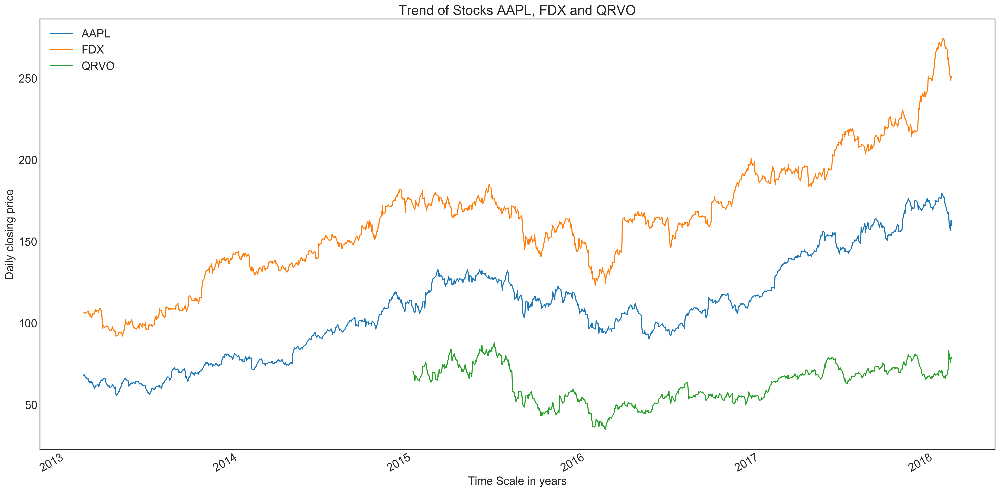

In [16]:
plt.style.use('seaborn-white')

plt.rcParams["figure.figsize"] = [20, 10]
plt.rcParams['figure.dpi'] = 300
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(figsize=(20, 10))
for name, df in stock_picks.groupby('name'):
    df.close.plot(kind="line", ax=ax, label=name)

plt.legend()
plt.title('Trend of Stocks AAPL, FDX and QRVO')
plt.ylabel('Daily closing price')
plt.xlabel('Time Scale in years')
plt.tight_layout()
filename = 'Trend_of_Stocks_plot.jpeg'
plt.savefig(filename, dpi=300)

In [17]:
# Extract the data by, the stock ticker, to a separate dataframe for plotting, PACF and other calculations

aapl_stock = stock_data[stock_data.name == 'AAPL']
fdx_stock = stock_data[stock_data.name == 'FDX']
qrvo_stock = stock_data[stock_data.name == 'QRVO']

# Keep a copy of the aapl_stock dataframe to run it through Linear Regression model
aapl_copy = aapl_stock.copy()
fdx_copy = fdx_stock.copy()
fdx_copy = qrvo_stock.copy()

# Drop the volume column for ARIMA modeling only
aapl_stock.drop(columns='volume', inplace=True)
fdx_stock.drop(columns='volume', inplace=True)
qrvo_stock.drop(columns='volume', inplace=True)

<h2>Our modeling approach:</h2><br>
For each stock we do the following:<br>
1. Exploratory Data Analysis: Calculate SMA for a couple of stocks and plot them with original close value<br>
2. Plot the ACF to see if there is any white noise<br>
3. Plot PACF to check if the series is an AR (Auto-regression) or MA (Moving Average) series<br>
4. Plot Decomposition plots for the 3 stocks<br>
5. Run ARIMA and find the optimal p, d and q values<br>
6. Run the LSTM model<br>
7. Run plain, vanilla Linear Regression model<br>
8. Run Random Forest model<br>
9. Compare the results, infer them to see which model is the best<br>


<h2>Exploratory Data Analysis</h2><br>
For each stock we do the following:

a. Calculate the simple moving average (SMA). These averages, along with the raw data, are useful for RandomForest Regressor, Linear Regressor.<br>
b. Plot the ACF and PACF values - useful for ARIMA models<br>
c. Decomposition plots to identify trend, seasonality and white noise

In [18]:
# The dataset contains data for each weekday from Monday through Friday
# Calculate the simple moving average over a window of 30 values to aggregate of stock price for approx. a month
aapl_sma = pd.DataFrame(columns=['close'])
aapl_sma['close'] = aapl_stock['close'].rolling(window=30).mean()

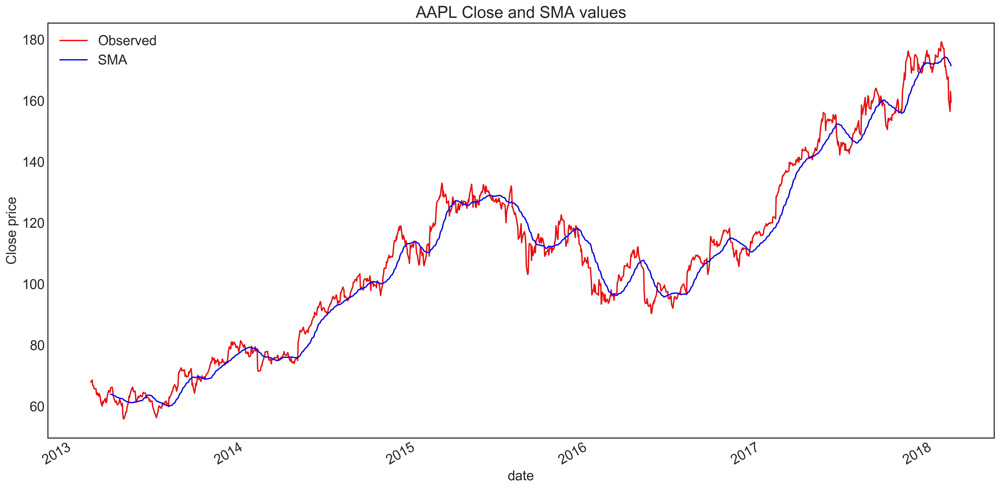

In [19]:
# Plot the simple moving average data for AAPL
# Compared to the raw data this plot is smoother but retains the same trend and any seasonalities
plt.xlabel('Date')
plt.ylabel('Close price')
plt.title('AAPL Close and SMA values')
aapl_stock.close.plot(c='r')
aapl_sma.close.plot(c='b')
plt.legend(labels=['Observed', 'SMA'], loc='best')
filename = 'AAPL_Close_SMA_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

In [20]:
# The FDX dataset contains data for each weekday from Monday through Friday
# Calculate the simple moving average over a window of 30 values to aggregate of stock price for approx. a month
fdx_sma = pd.DataFrame(columns=['close'])
fdx_sma['close'] = fdx_stock['close'].rolling(window=30).mean()

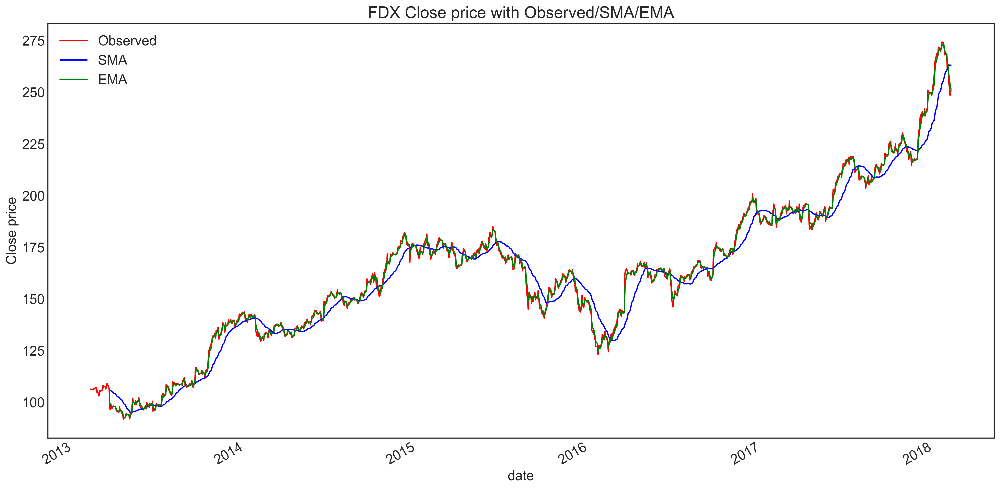

In [21]:
# Plot the simple moving average data for FDX
# Compared to the raw data this plot is smoother but retains the same trend and any seasonalities
plt.xlabel('Date')
plt.ylabel('Close price')
plt.title('FDX Close price with Observed/SMA/EMA')
fdx_stock.close.plot(c='r')
fdx_sma.close.plot(c='b')
plt.legend(labels=['Observed', 'SMA'], loc='best')
plt.show()

In [22]:
# The dataset contains data for each weekday from Monday through Friday
# Calculate the simple moving average over a window of 30 values to aggregate of stock price for approx. a month
qrvo_sma = pd.DataFrame(columns=['close'])
qrvo_sma['close'] = qrvo_stock['close'].rolling(window=30).mean()

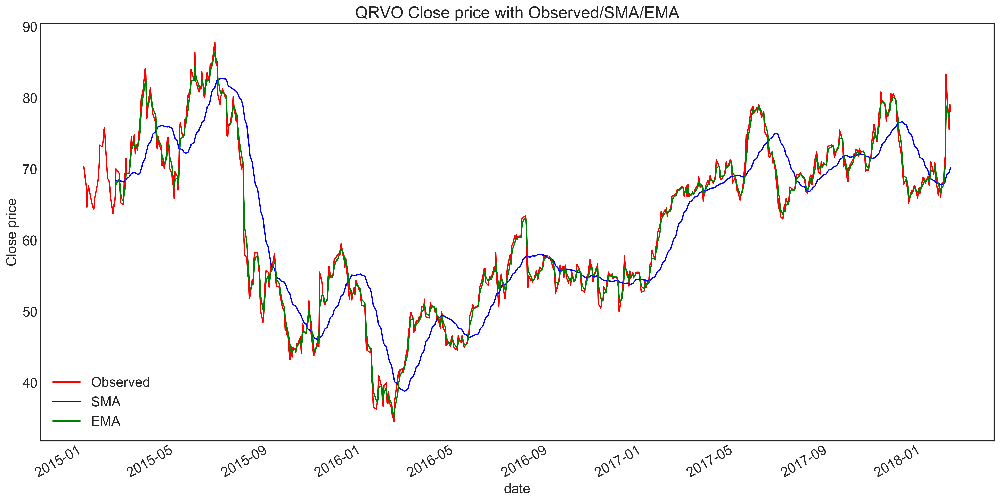

In [23]:
# Plot the simple moving average data for QRVO
# Compared to the raw data this plot is smoother but retains the same trend and any seasonalities
plt.xlabel('Date')
plt.ylabel('Close price')
plt.title('QRVO Close price with Observed/SMA')
qrvo_stock.close.plot(c='r')
qrvo_sma.close.plot(c='b')
plt.legend(labels=['Observed', 'SMA'], loc='best')
plt.show()

<h2>ACF/PACF Plots</h2><br>
ACF and PACF plots give a lot of information about the time series data. For example if the ACF decays slowly towards zero then it indicates that the series has a trend. And ACF near zero means there is a noise in the data. Such noise can be removed using techniques such as simple moving average (SMA) or exponentially weighted moving average (EWMA).<br>
<br>If PACF does not lag beyond a certain point, let's say k, then it is an AR(k) model.<br>
<br>The reverse is true for MA (moving average) series. That is, if PACF graph moves towards a zero then this is a MA series. And the number of non-zero autocorrelations will tell us the order of the MA series e.g. MA(k).

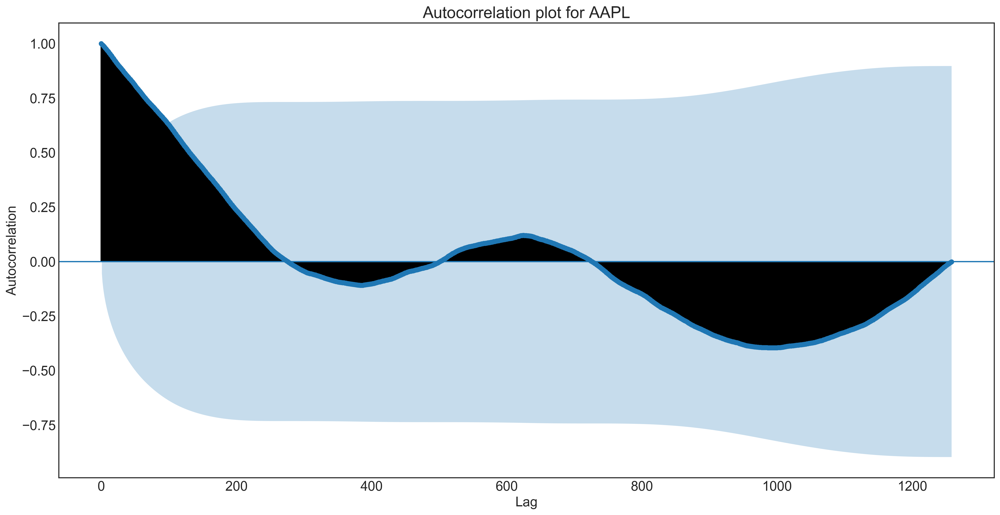

In [24]:
plot_acf(aapl_stock.close)
plt.ylabel('Autocorrelation')
plt.xlabel('Lag')
plt.title('Autocorrelation plot for AAPL')
filename = 'Autocorr_AAPL_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

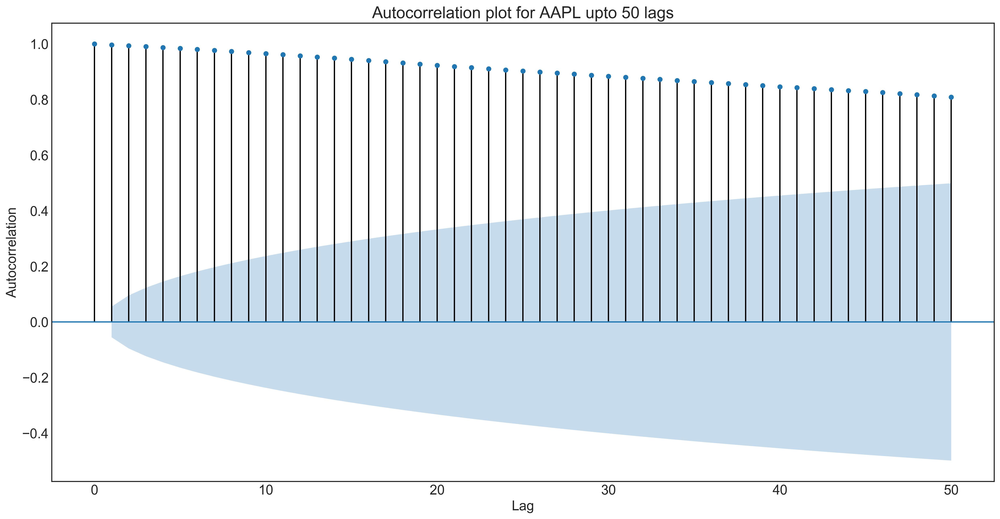

In [25]:
# Plot the ACF for first 50 lags only to expand the scale and check for convergence

plot_acf(aapl_stock.close, lags=50)
plt.ylabel('Autocorrelation')
plt.xlabel('Lag')
plt.title('Autocorrelation plot for AAPL upto 50 lags')
filename = 'Autocorr_50_Lags_AAPL_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

PACF is plotted first on the closing price and then again on the first difference. That is, the second element in the column is subtracted with the first, and the third with the second and so on.

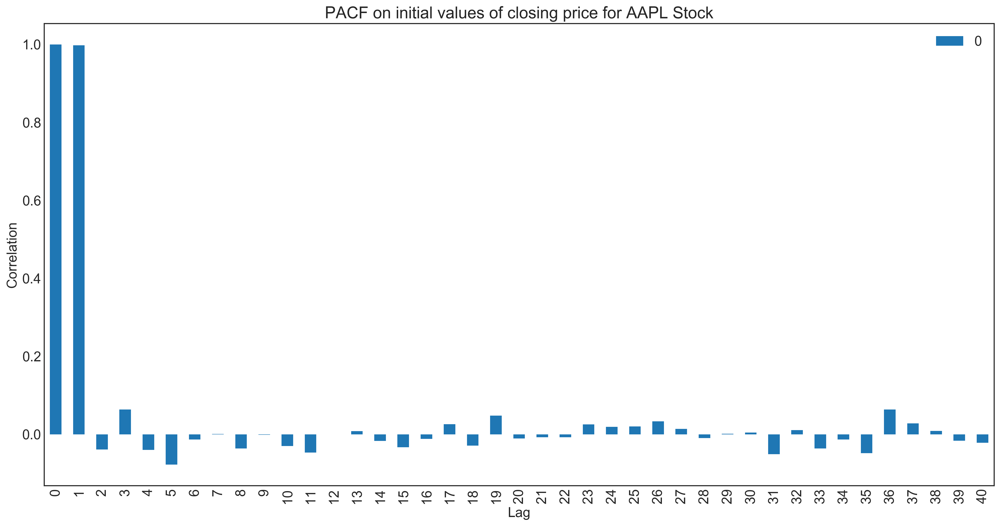

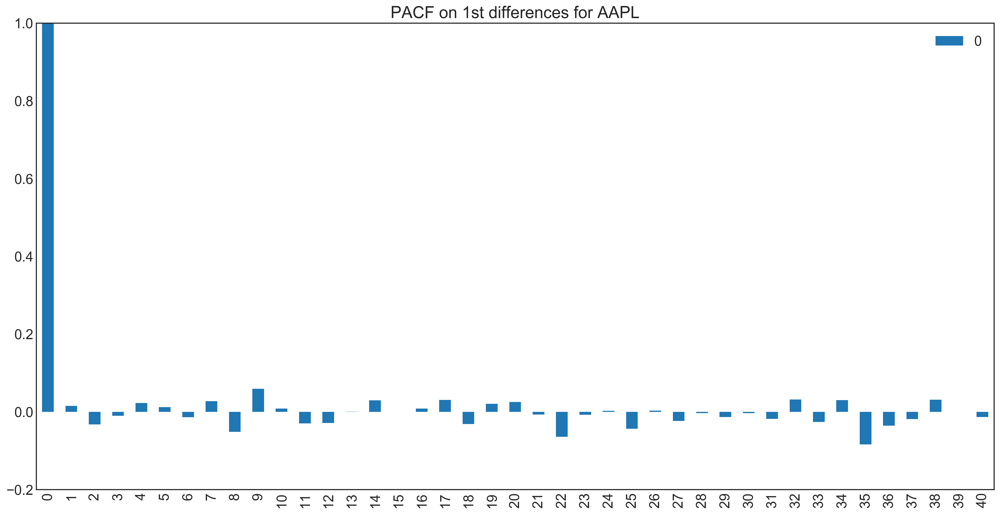

In [26]:
pacf_plot(aapl_stock, 'AAPL')
induce_stationarity(aapl_stock, 'AAPL')

For AAPL the ACF plot shows a gradual and slow convergence to zero.<br>
<br>The values in the light blue shaded region can be ignored as they are very close zero. And the PACF plot shows a significant correlation at lag 1. This means the series is an AR(1) series and that it has a trend.<br>
<br>
The ACF and PACF plots also indicate us about the p and q values in ARIMA model.

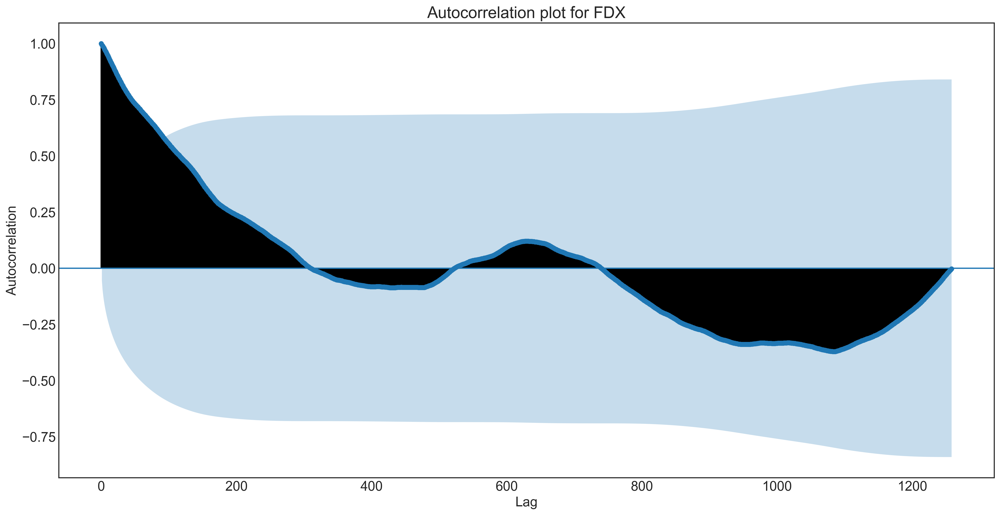

In [27]:
plot_acf(fdx_stock.close)
plt.ylabel('Autocorrelation')
plt.xlabel('Lag')
plt.title('Autocorrelation plot for FDX')
filename = 'Autocorr_FDX_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

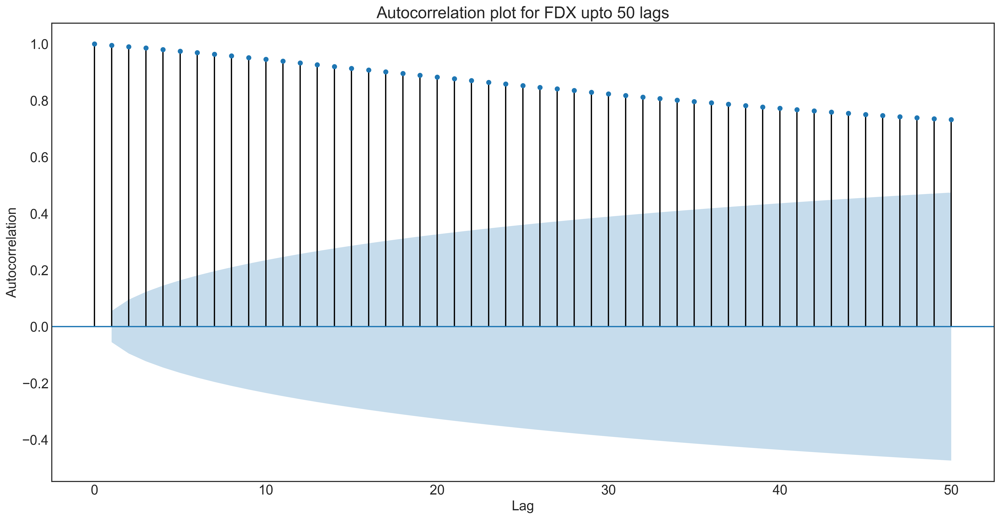

In [28]:
plot_acf(fdx_stock.close, lags=50)
plt.ylabel('Autocorrelation')
plt.xlabel('Lag')
plt.title('Autocorrelation plot for FDX upto 50 lags')
filename = 'Autocorr_50_Lags_FDX_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

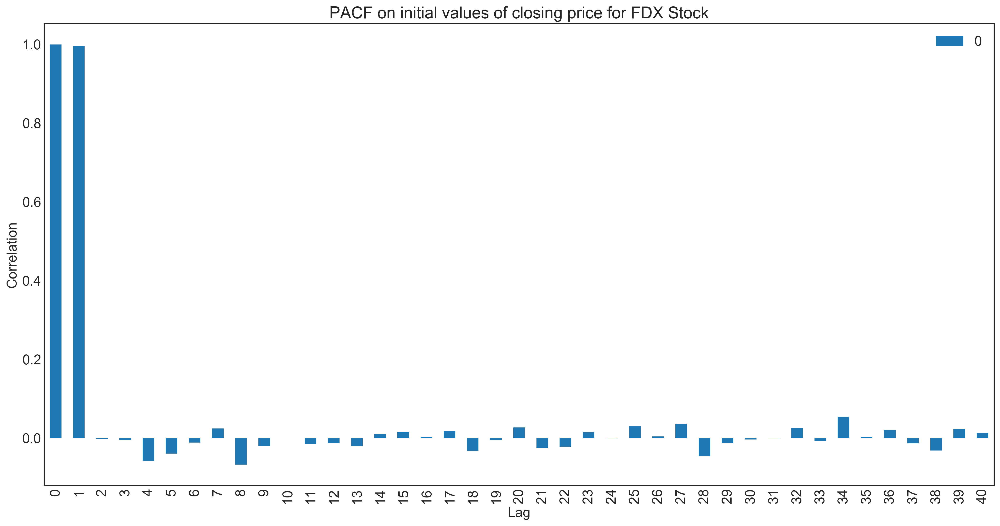

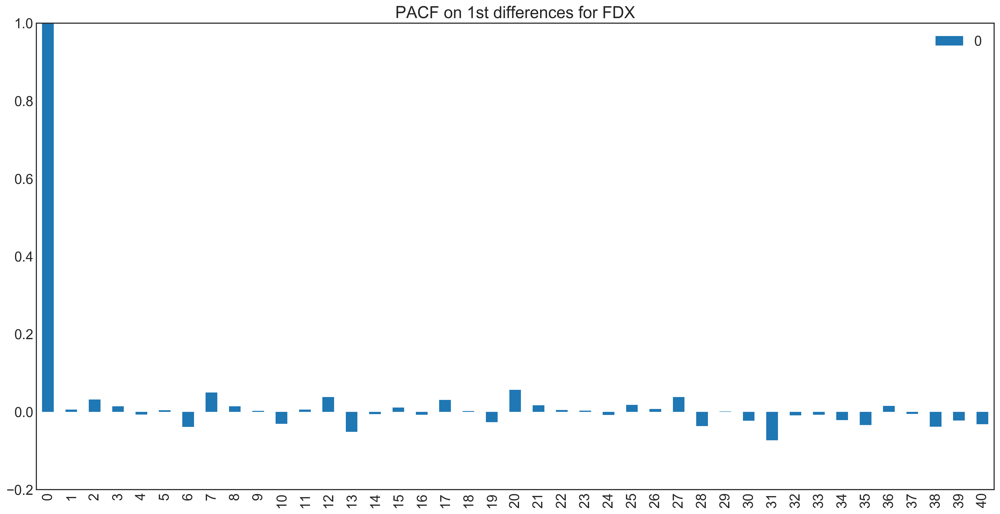

In [29]:
pacf_plot(fdx_stock, 'FDX')
induce_stationarity(fdx_stock, 'FDX')

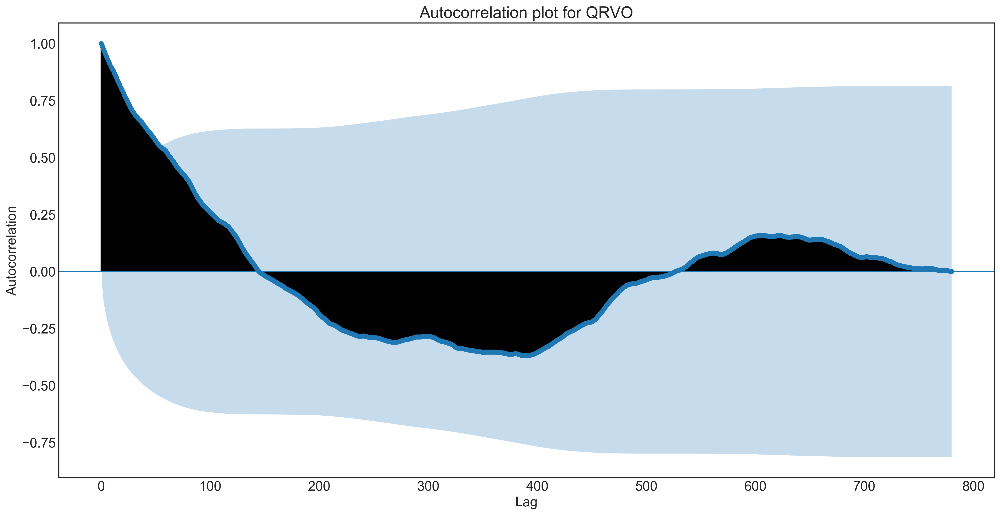

In [30]:
plot_acf(qrvo_stock.close)
plt.ylabel('Autocorrelation')
plt.xlabel('Lag')
plt.title('Autocorrelation plot for QRVO')
filename = 'Autocorr_QRVO_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

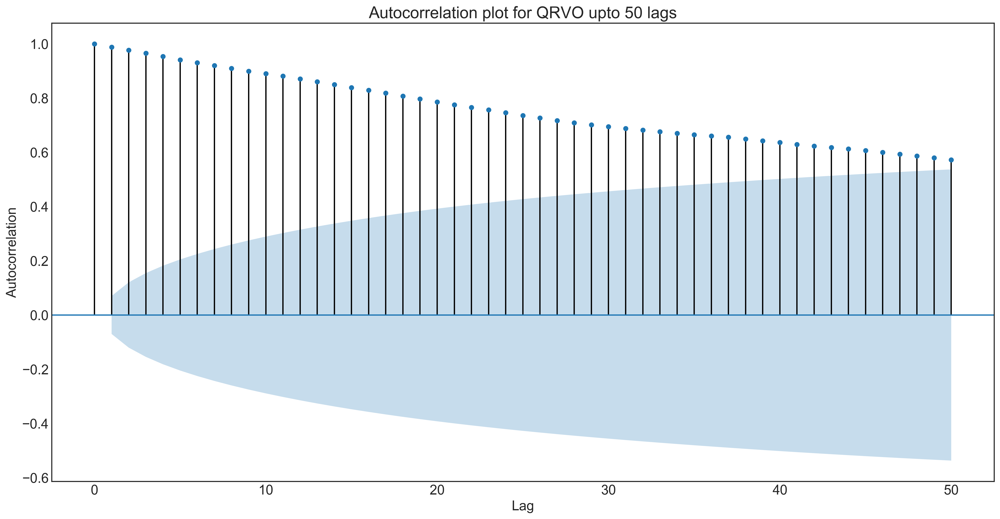

In [31]:
plot_acf(qrvo_stock.close, lags=50)
plt.ylabel('Autocorrelation')
plt.xlabel('Lag')
plt.title('Autocorrelation plot for QRVO upto 50 lags')
filename = 'Autocorr_50_lags_QRVO_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

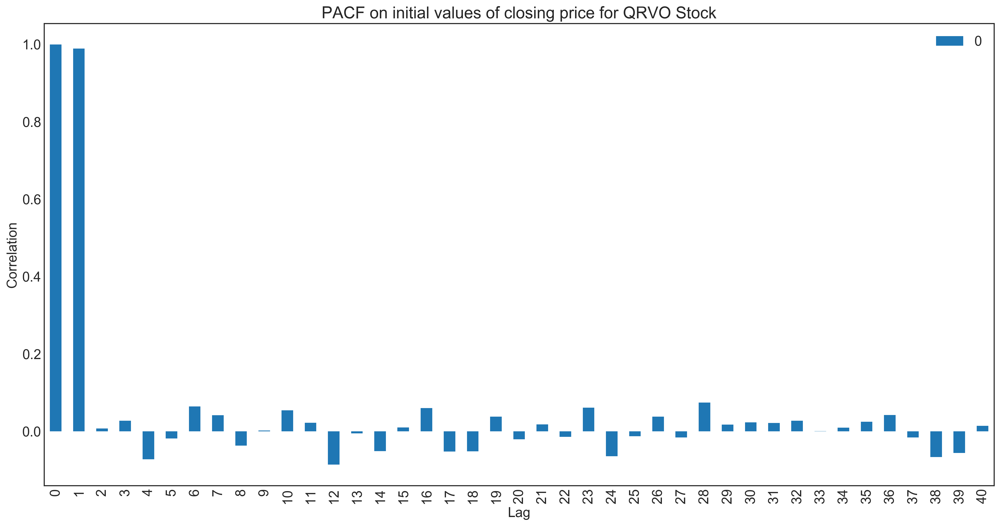

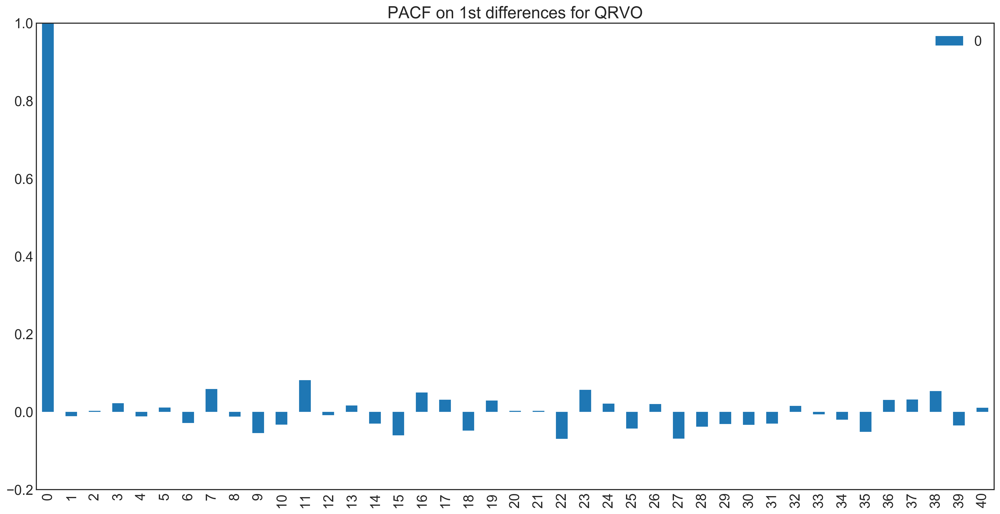

In [32]:
pacf_plot(qrvo_stock, 'QRVO')
induce_stationarity(qrvo_stock, 'QRVO')

<h2>Decomposition Plots</h2><br>
Next, we plot the decomposition plots to identify the seasonality and trends in the data. Some models compensate for the seasonality change. If the data has a trend that means there is no white noise in the data.<br>
<br>
Stock prices are not usually seasonal unlike, for e.g. temperature in weather data. Here, we will skip the steps for any seasonal adjustment.

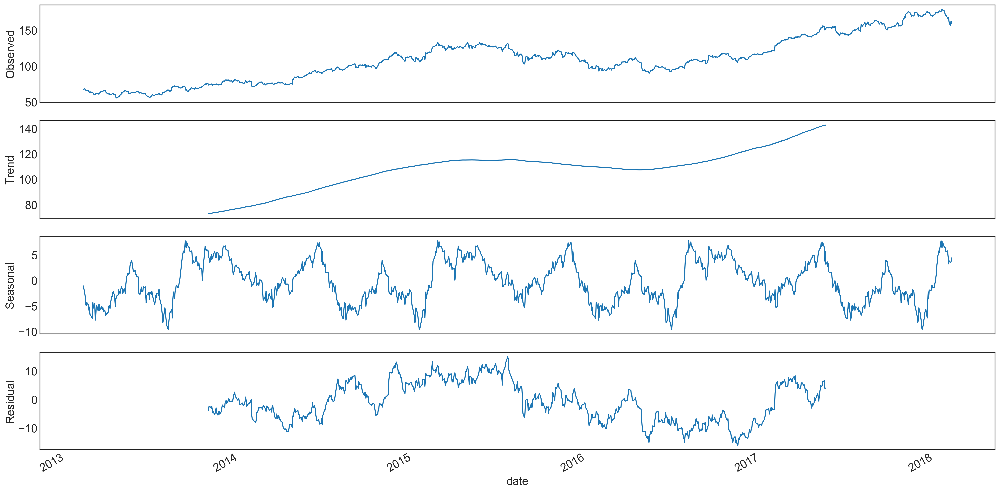

In [33]:
# Decompose the AAPL data to show overall trend in data - data appears to be seasonally dependent
decomp = seasonal_decompose(aapl_stock.close, model='additive', freq=365)
decomp.plot()
filename = 'Decomp_AAPL_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

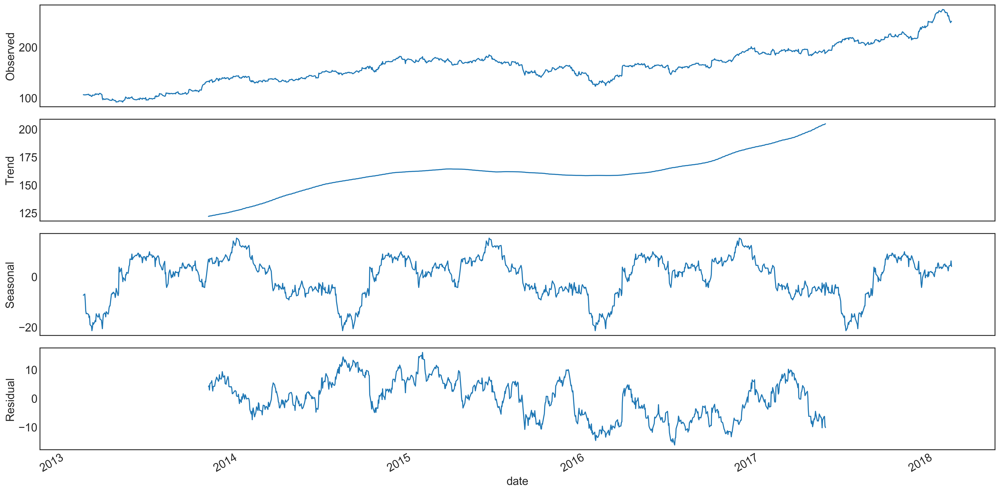

In [34]:
# Decompose the FDX data to show overall trend in data - data appears to be seasonally dependent
# The decomp function needs a frequency parameter which 365 here because we have the daily values of the stock
decomp = seasonal_decompose(fdx_stock.close, model='additive', freq=365)
decomp.plot()
filename = 'Decomp_FDX_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

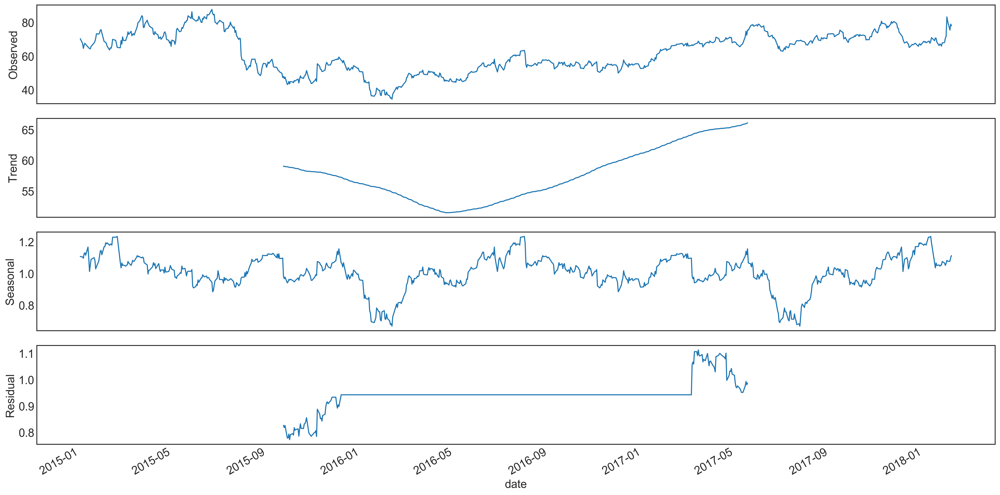

In [35]:
# Decompose the QRVO data to show overall trend in data - data appears to be seasonally dependent
decomp = seasonal_decompose(qrvo_stock.close, model='multiplicative', freq=365)
decomp.plot()
filename = 'Decomp_QRVO_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

The decomposition plots for all 3 stocks show some seasonality and trend. We will take care of the seasonality part using the SARIMA model (where S stands for Seasonality).

<h2>ARIMA Modeling</h2>

<h2>ARIMA-AAPL-Close price</h2><br>
The first modeling technique we use is ARIMA. Here we look for the lowest AIC value to get the optimal p, d and q parameters for the model. Once we find the optimal p, d and q values we call the 'arima_specific' function to print the model summary and plot the residuals and the forecasted stock price.

In [36]:
arima_trials(aapl_stock, 'AAPL')

ARIMA params for  AAPL  =  (0, 0, 0)  - AIC:  12186.408478862091
ARIMA params for  AAPL  =  (0, 0, 1)  - AIC:  10526.589425187827
ARIMA params for  AAPL  =  (0, 1, 0)  - AIC:  4716.111652325981
ARIMA params for  AAPL  =  (0, 1, 1)  - AIC:  4717.799319165133
ARIMA params for  AAPL  =  (0, 1, 2)  - AIC:  4718.540181220545
ARIMA params for  AAPL  =  (0, 2, 0)  - AIC:  5562.699826380353
ARIMA params for  AAPL  =  (0, 2, 1)  - AIC:  4722.420589683508
ARIMA params for  AAPL  =  (0, 2, 2)  - AIC:  4724.079583482782
ARIMA params for  AAPL  =  (1, 0, 0)  - AIC:  4730.643045240879
ARIMA params for  AAPL  =  (1, 0, 1)  - AIC:  4732.208275747267
ARIMA params for  AAPL  =  (1, 0, 2)  - AIC:  4733.1566003511625
ARIMA params for  AAPL  =  (1, 1, 0)  - AIC:  4717.819594814397
ARIMA params for  AAPL  =  (1, 2, 0)  - AIC:  5243.601187272494
ARIMA params for  AAPL  =  (1, 2, 1)  - AIC:  4724.100659477893
ARIMA params for  AAPL  =  (1, 2, 2)  - AIC:  4724.344488071991
ARIMA params for  AAPL  =  (2, 0, 0) 

We pick the p, d, and q values for the lowest AIC value which is 0, 1, 0 and print the model. This is a special type of time series called Random Walk that has no AR or MA terms but just the differences or d term.

                             ARIMA Model Results                              
Dep. Variable:                D.close   No. Observations:                 1258
Model:                 ARIMA(0, 1, 0)   Log Likelihood               -2356.056
Method:                           css   S.D. of innovations              1.574
Date:                Wed, 31 Jul 2019   AIC                           4716.112
Time:                        07:56:05   BIC                           4726.386
Sample:                             1   HQIC                          4719.973
                                                                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0729      0.044      1.642      0.101      -0.014       0.160
Residuals Description
count    1.258000e+03
mean     7.636531e-09
std      1.575098e+00
min     -7.352882e+00
25%     -7.307322e-01

<Figure size 6000x3000 with 0 Axes>

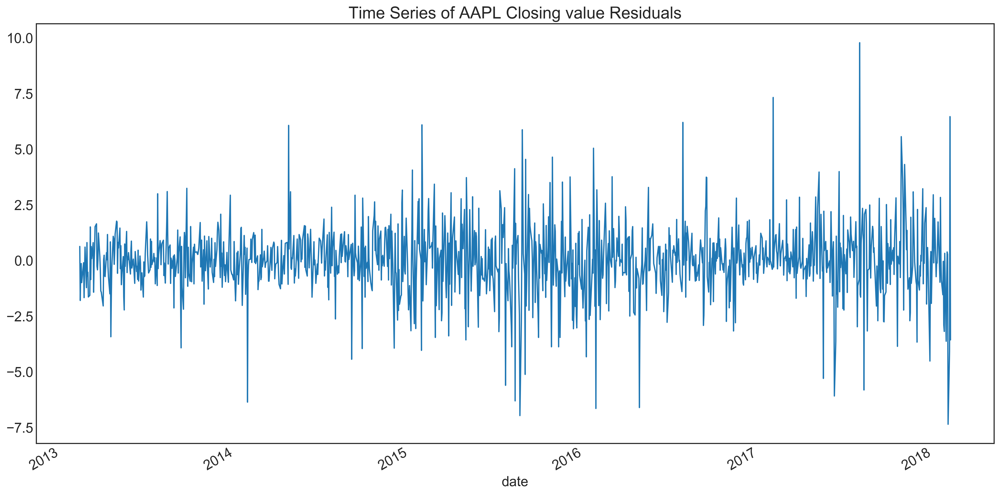

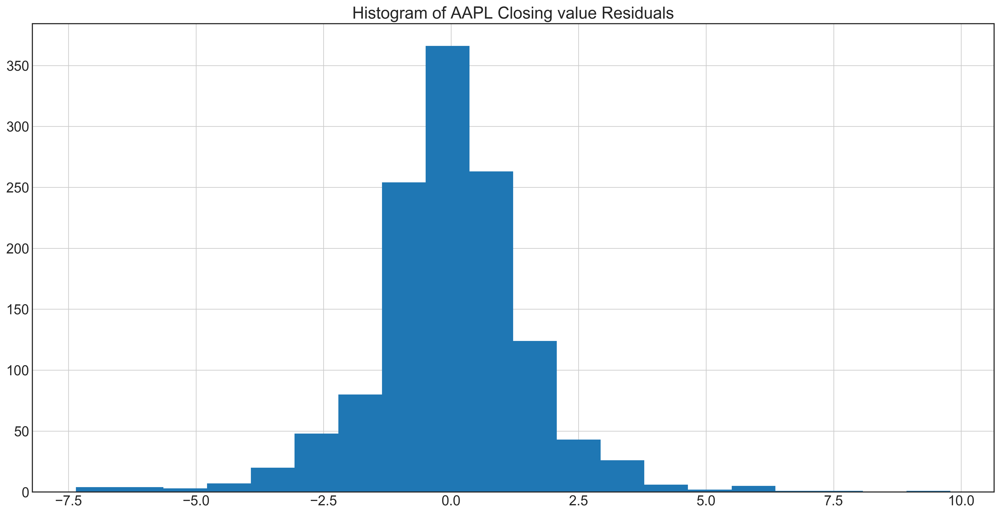

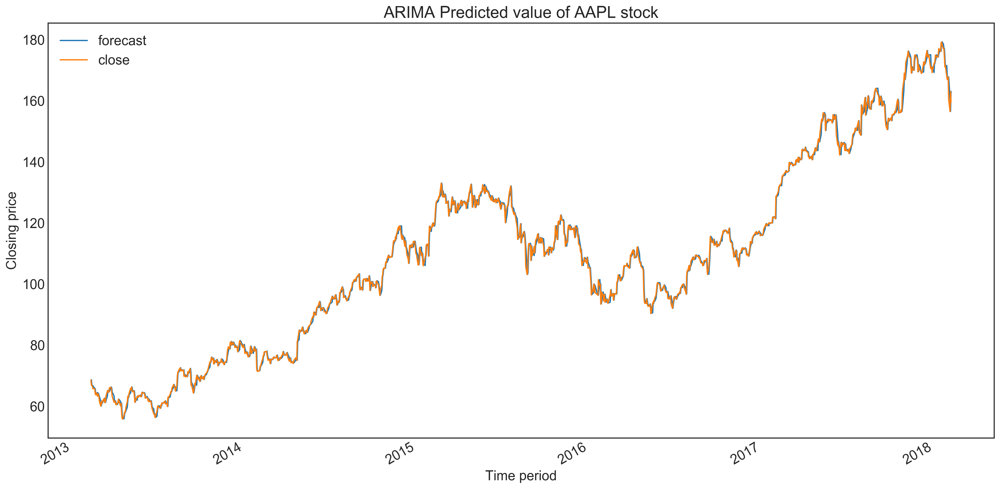

In [37]:
arima_specific(aapl_stock, 'AAPL', 0, 1, 0)

In [38]:
# Cross validate our model by splitting training and testing datasets at a 70-30 split ratio

# Create Training and Test

train_size = int(round(aapl_stock.shape[0]*0.70, 0))
train_data = aapl_stock.close[:train_size]
test_data = aapl_stock.close[train_size:]
test_size = test_data.shape

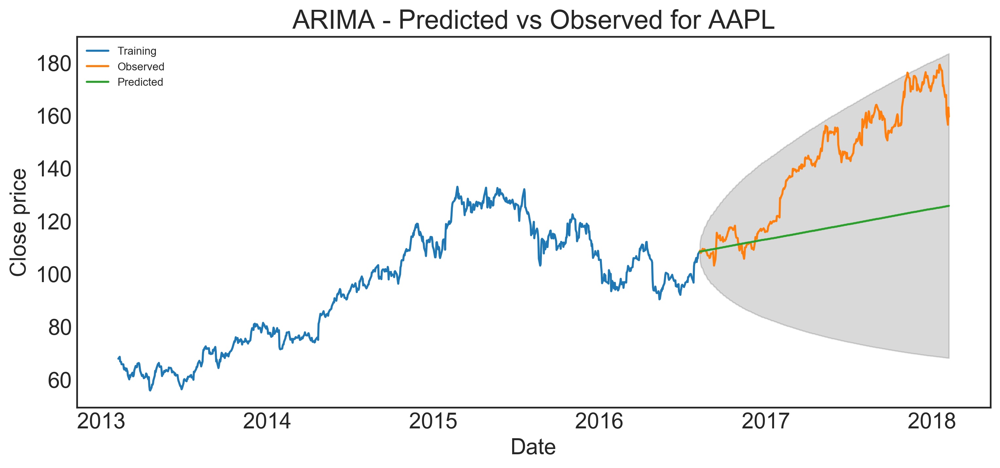

In [39]:
fc = print_forecast('AAPL', train_data, test_data, test_size, 0, 1, 0)

In [40]:
# Calculate accuracy metrics for AAPL (regular close value and not SMA)
error_stats = pd.DataFrame()
errors = print_accuracy(fc, test_data)
errors.update({'model': 'ARIMA', 'stock': 'AAPL-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>Observation from ARIMA model</h2>

The ARIMA results are very encouraging. The 0, 1, 0 model shows the correct trend of the stock price but is still not close. We can run the auto-arima model to see if that finds better p, d and q values. By tweaking the model we could achieve better forecasts. While tweaking the model we must monitor the P value to be less than 0.05.

What we tried above was with the raw data. Next we try ARIMA model with the simple moving average (SMA) of the stock's daily `close` value.

<h2>ARIMA-AAPL-Simple Moving Average of 30 days</h2>

In [41]:
# Because we calculated a 30-day simple moving average the first 30 entries in aapl_sma will be NaN
# Models will crash on NaN rows. So move the data up to fill index 0 in the dataframe
aapl_sma = aapl_sma[30:]

In [42]:
# Run ARIMA on the SMA data of AAPL
arima_trials(aapl_sma, 'AAPL-SMA')

ARIMA params for  AAPL-SMA  =  (0, 0, 0)  - AIC:  11816.485241368206
ARIMA params for  AAPL-SMA  =  (0, 0, 1)  - AIC:  10125.257964801822
ARIMA params for  AAPL-SMA  =  (0, 1, 0)  - AIC:  338.2908711872234
ARIMA params for  AAPL-SMA  =  (0, 1, 1)  - AIC:  -977.4625347075403
ARIMA params for  AAPL-SMA  =  (0, 2, 0)  - AIC:  -2917.447968066809
ARIMA params for  AAPL-SMA  =  (0, 2, 1)  - AIC:  -2917.715181306367
ARIMA params for  AAPL-SMA  =  (0, 2, 2)  - AIC:  -2918.1502542167996
ARIMA params for  AAPL-SMA  =  (1, 0, 0)  - AIC:  475.8189540558028
ARIMA params for  AAPL-SMA  =  (1, 1, 0)  - AIC:  -2935.5099108568206
ARIMA params for  AAPL-SMA  =  (1, 1, 1)  - AIC:  -2938.072876064463
ARIMA params for  AAPL-SMA  =  (1, 1, 2)  - AIC:  -2936.8518642879076
ARIMA params for  AAPL-SMA  =  (1, 2, 0)  - AIC:  -2917.508979952225
ARIMA params for  AAPL-SMA  =  (1, 2, 2)  - AIC:  -2935.5585254572557
ARIMA params for  AAPL-SMA  =  (2, 0, 0)  - AIC:  -2922.4966479627396
ARIMA params for  AAPL-SMA  =  

                             ARIMA Model Results                              
Dep. Variable:               D2.close   No. Observations:                 1227
Model:                 ARIMA(2, 2, 1)   Log Likelihood                1463.082
Method:                       css-mle   S.D. of innovations              0.073
Date:                Wed, 31 Jul 2019   AIC                          -2916.164
Time:                        07:57:19   BIC                          -2890.603
Sample:                             2   HQIC                         -2906.546
                                                                              
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
const             -0.0004      0.002     -0.169      0.866      -0.004       0.004
ar.L1.D2.close    -0.0072      0.616     -0.012      0.991      -1.214       1.199
ar.L2.D2.close    -0.0445      0.039

<Figure size 6000x3000 with 0 Axes>

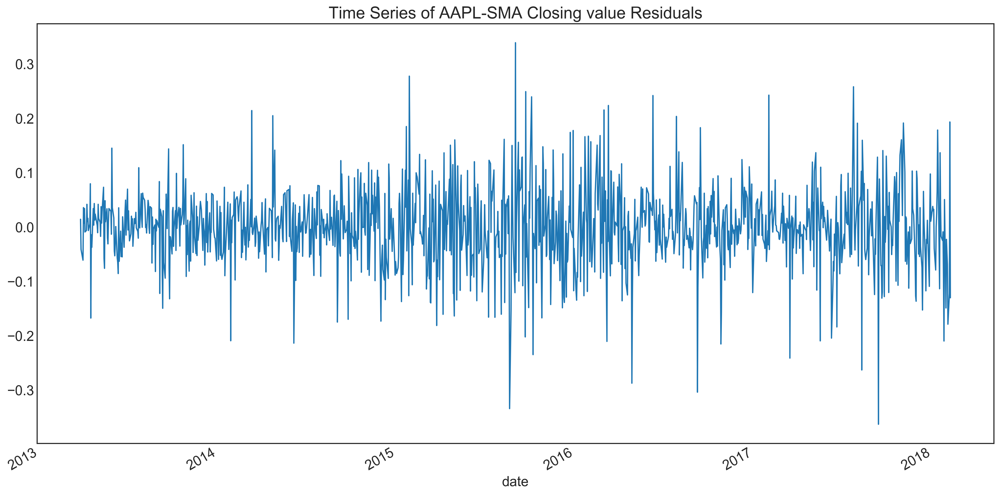

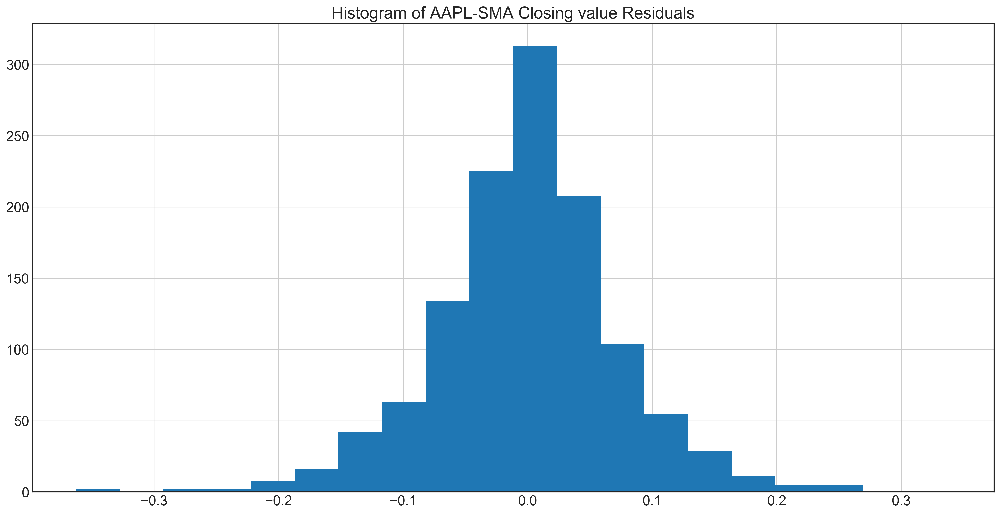

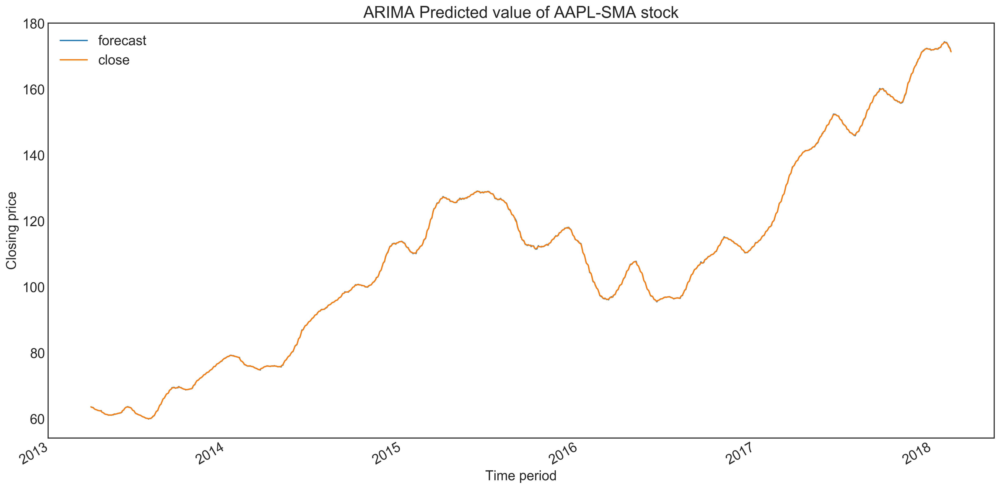

In [43]:
arima_specific(aapl_sma, 'AAPL-SMA', 2, 2, 1)

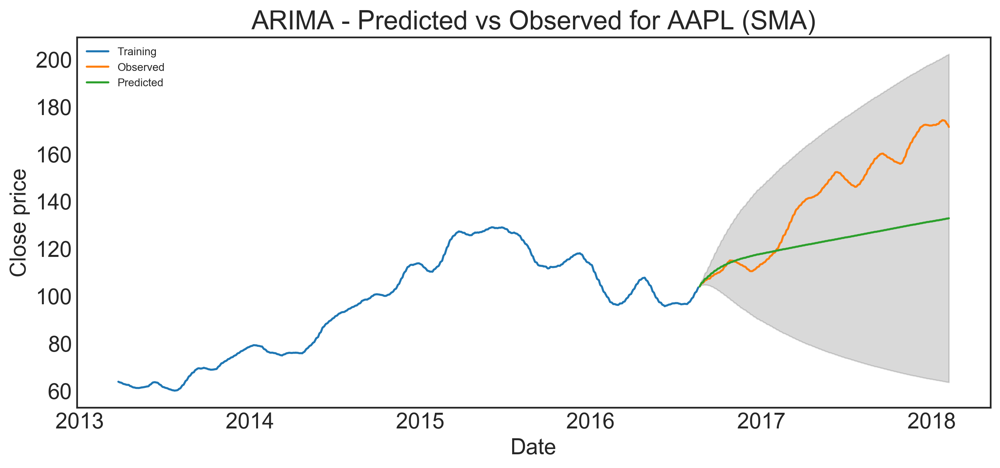

In [44]:
# Cross validate our model by splitting training and testing datasets at a 70-30 split ratio

# Create Training and Test

train_size = int(round(aapl_sma.shape[0]*0.70, 0))
train_data = aapl_sma.close[:train_size]
test_data = aapl_sma.close[train_size:]
test_size = test_data.shape

fc = print_forecast('AAPL (SMA)', train_data, test_data, test_size, 2, 1, 2)

In [45]:
# Calculate accuracy metrics for AAPL (regular close value and not SMA)
errors = print_accuracy(fc, test_data)
errors.update({'model': 'ARIMA', 'stock': 'AAPL-SMA'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>Observation of ARIMA model with SMA</h2>
<br>
The model with simple moving average or SMA did not perform well relative to the model with raw data. As one can see the shaded area which is the confidence interval for predictions is less perfect than the model with raw data. This could be because we aggregate the data of 5 days (Mon-Fri) into one value, and that could affect the accuracy of the model.

<h2>Validating ARIMA model with other stocks</h2><br>
We want to validate our ARIMA model with other stocks in case Apple is volatile. Below we try the same steps as we did with `AAPL` with two other stocks - `FDX` (FedEx Corp.) and `QRVO` (Qorvo Inc.) a semiconductor company by plotting the ACF, PACF, Decomposition plot and the ARIMA model.

<h2>ARIMA-FDX-Close price</h2>

In [46]:
arima_trials(fdx_stock, 'FDX')

ARIMA params for  FDX  =  (0, 0, 0)  - AIC:  12654.638892078481
ARIMA params for  FDX  =  (0, 0, 1)  - AIC:  11011.114484943075
ARIMA params for  FDX  =  (0, 0, 2)  - AIC:  9742.198413779279
ARIMA params for  FDX  =  (0, 1, 0)  - AIC:  5413.649431560444
ARIMA params for  FDX  =  (0, 1, 1)  - AIC:  5415.609649212136
ARIMA params for  FDX  =  (0, 1, 2)  - AIC:  5416.351359633043
ARIMA params for  FDX  =  (0, 2, 0)  - AIC:  6274.207318236496
ARIMA params for  FDX  =  (0, 2, 1)  - AIC:  5418.8868071488305
ARIMA params for  FDX  =  (1, 0, 0)  - AIC:  5430.389277848467
ARIMA params for  FDX  =  (1, 0, 1)  - AIC:  5432.28755997193
ARIMA params for  FDX  =  (1, 0, 2)  - AIC:  5432.766450143494
ARIMA params for  FDX  =  (1, 1, 0)  - AIC:  5415.607143028398
ARIMA params for  FDX  =  (1, 2, 0)  - AIC:  5892.491318332033
ARIMA params for  FDX  =  (1, 2, 1)  - AIC:  5420.839120292159
ARIMA params for  FDX  =  (1, 2, 2)  - AIC:  5422.131474526334
ARIMA params for  FDX  =  (2, 0, 0)  - AIC:  5432.280

                             ARIMA Model Results                              
Dep. Variable:                D.close   No. Observations:                 1258
Model:                 ARIMA(0, 1, 0)   Log Likelihood               -2704.825
Method:                           css   S.D. of innovations              2.077
Date:                Wed, 31 Jul 2019   AIC                           5413.649
Time:                        07:58:12   BIC                           5423.924
Sample:                             1   HQIC                          5417.511
                                                                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.1151      0.059      1.964      0.050       0.000       0.230
Residuals Description
count    1.258000e+03
mean    -4.792732e-08
std      2.078317e+00
min     -7.775056e+00
25%     -1.035056e+00

<Figure size 6000x3000 with 0 Axes>

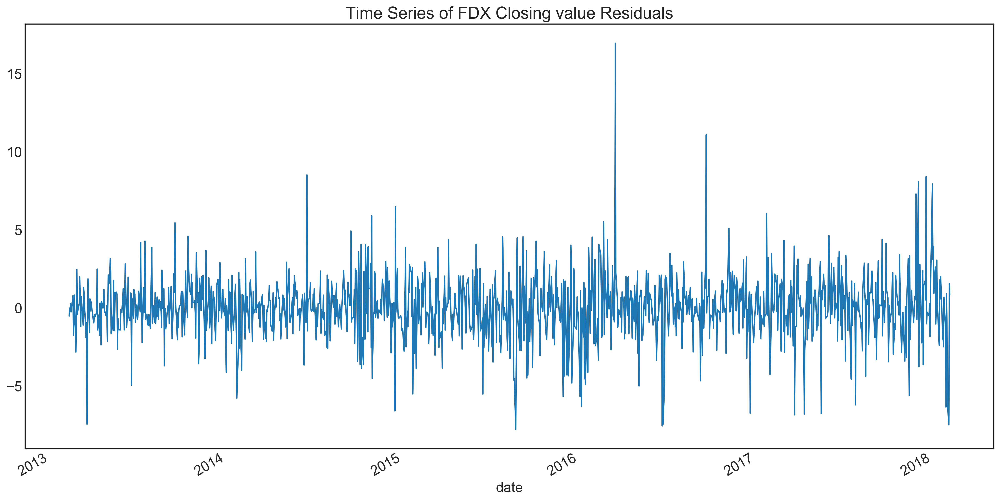

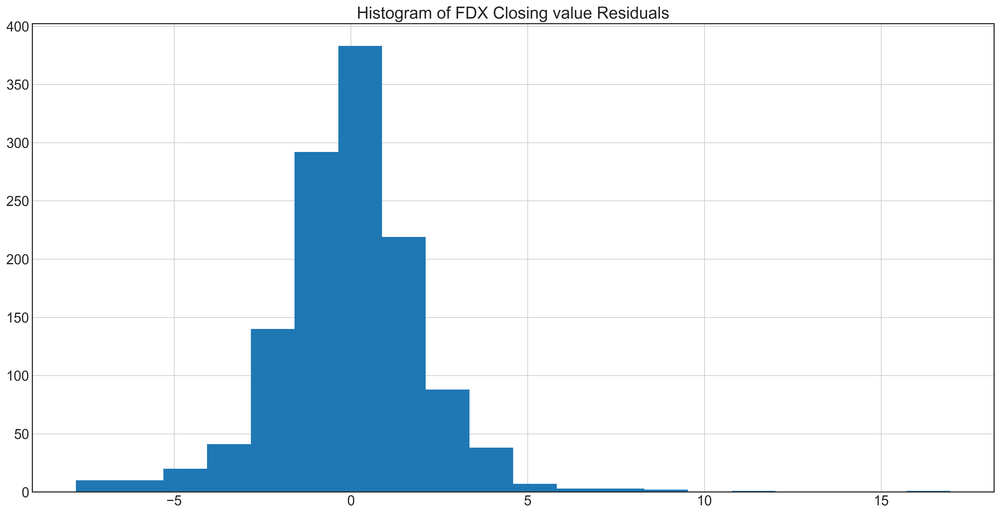

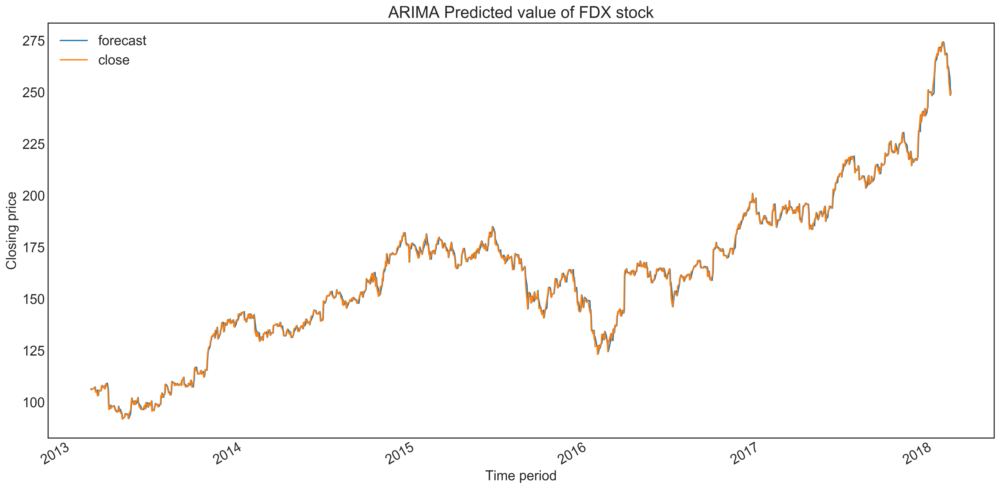

In [47]:
arima_specific(fdx_stock, 'FDX', 0, 1, 0)

In [48]:
# Cross validate our model by splitting training and testing datasets at a 70-30 split ratio

# Create Training and Test

train_size = int(round(fdx_stock.shape[0]*0.70, 0))
train_data = fdx_stock.close[:train_size]
test_data = fdx_stock.close[train_size:]
test_size = test_data.shape

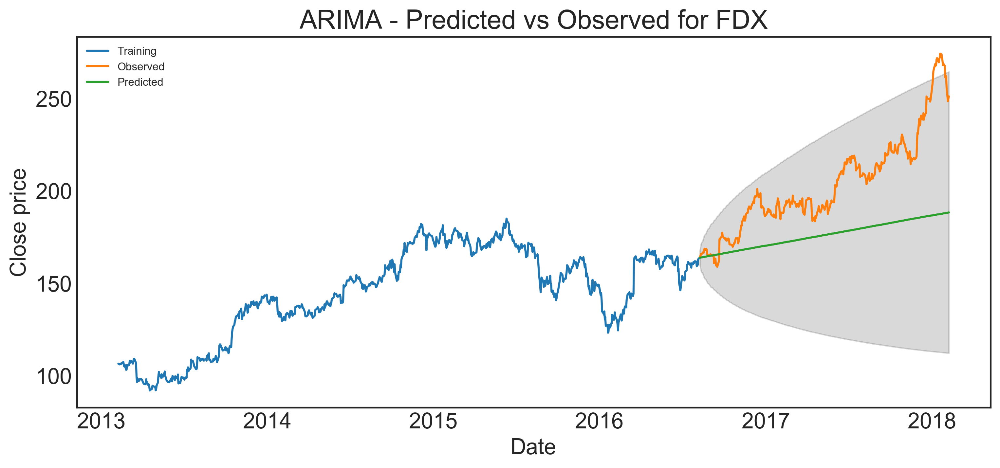

In [49]:
fc = print_forecast('FDX', train_data, test_data, test_size, 0, 1, 0)

In [50]:
errors = print_accuracy(fc, test_data)
errors.update({'model': 'ARIMA', 'stock': 'FDX-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>ARIMA-QRVO-Close price</h2>

In [51]:
arima_trials(qrvo_stock, 'QRVO')

ARIMA params for  QRVO  =  (0, 0, 0)  - AIC:  6042.345607729758
ARIMA params for  QRVO  =  (0, 0, 1)  - AIC:  5102.732391083597
ARIMA params for  QRVO  =  (0, 0, 2)  - AIC:  4495.752441321014
ARIMA params for  QRVO  =  (0, 1, 0)  - AIC:  3006.2735155555893
ARIMA params for  QRVO  =  (0, 1, 1)  - AIC:  3008.1782549234613
ARIMA params for  QRVO  =  (0, 1, 2)  - AIC:  3010.1705346829312
ARIMA params for  QRVO  =  (0, 2, 0)  - AIC:  3550.3919448697666
ARIMA params for  QRVO  =  (0, 2, 1)  - AIC:  3011.2726270830312
ARIMA params for  QRVO  =  (1, 0, 0)  - AIC:  3011.984185680324
ARIMA params for  QRVO  =  (1, 0, 1)  - AIC:  3013.955294107681
ARIMA params for  QRVO  =  (1, 0, 2)  - AIC:  3015.910364602297
ARIMA params for  QRVO  =  (1, 1, 0)  - AIC:  3008.177722037647
ARIMA params for  QRVO  =  (1, 1, 1)  - AIC:  3010.1767616230045
ARIMA params for  QRVO  =  (1, 2, 0)  - AIC:  3320.0821384891565
ARIMA params for  QRVO  =  (1, 2, 1)  - AIC:  3013.182039353992
ARIMA params for  QRVO  =  (1, 2,

                             ARIMA Model Results                              
Dep. Variable:                D.close   No. Observations:                  780
Model:                 ARIMA(0, 1, 0)   Log Likelihood               -1501.137
Method:                           css   S.D. of innovations              1.658
Date:                Wed, 31 Jul 2019   AIC                           3006.274
Time:                        07:58:54   BIC                           3015.592
Sample:                             1   HQIC                          3009.858
                                                                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0099      0.059      0.166      0.868      -0.106       0.126
Residuals Description
count    7.800000e+02
mean     3.188333e-17
std      1.659037e+00
min     -9.994859e+00
25%     -7.923590e-01

<Figure size 6000x3000 with 0 Axes>

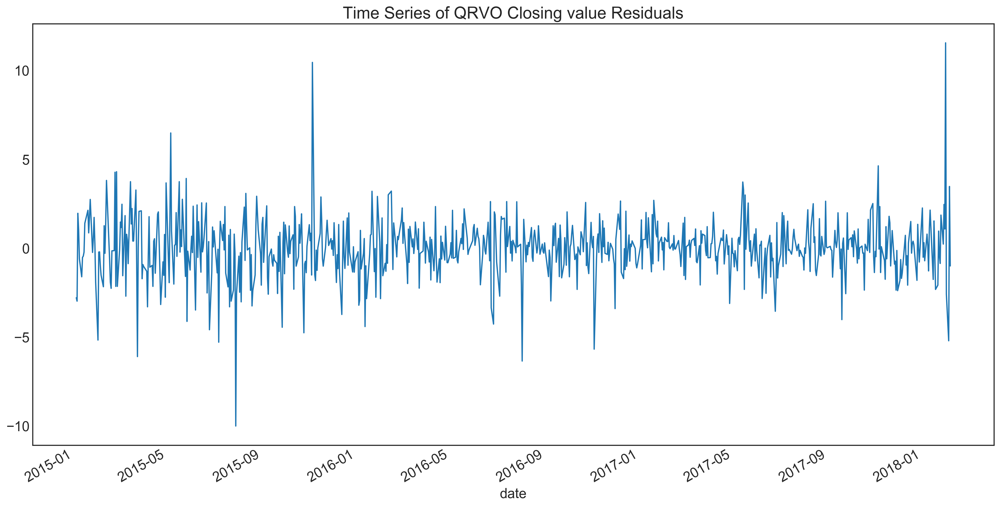

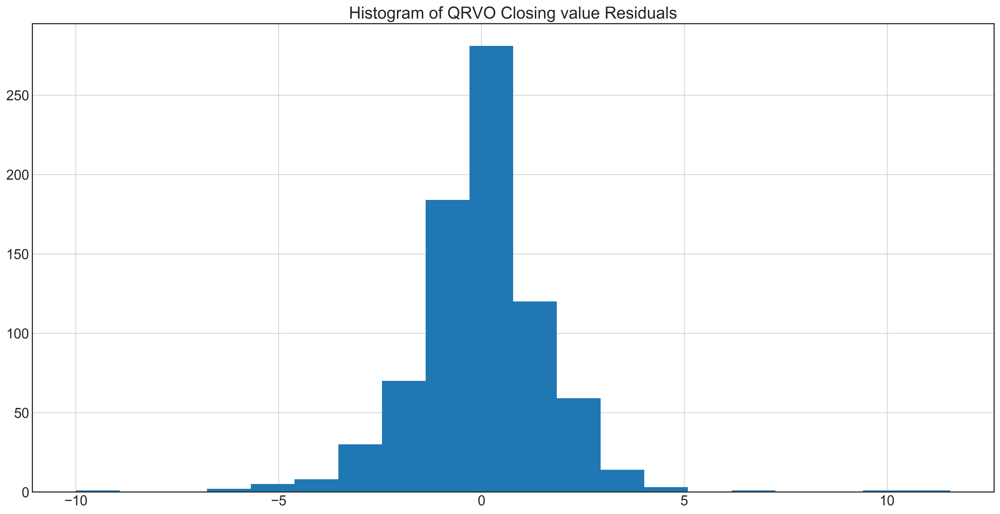

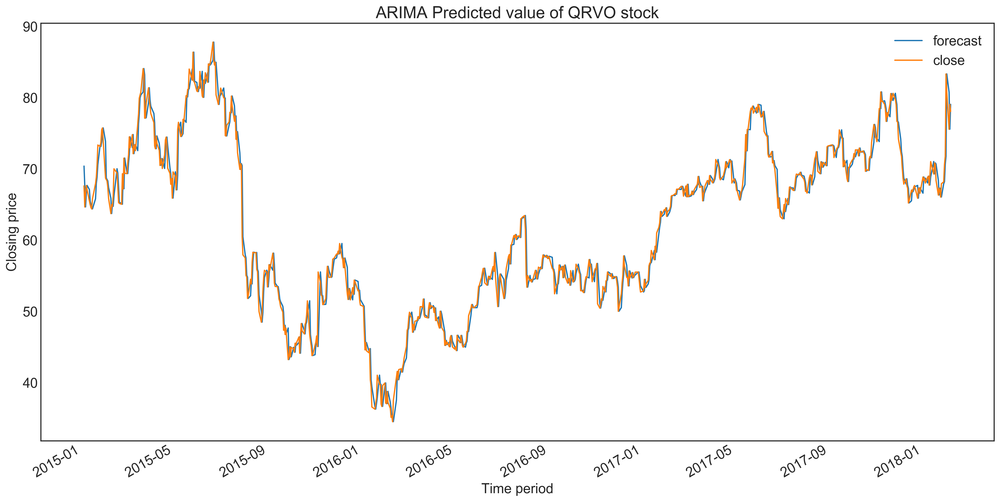

In [52]:
arima_specific(qrvo_stock, 'QRVO', 0, 1, 0)

In [53]:
# Cross validate our model by splitting training and testing datasets at a 70-30 split ratio

# Create Training and Test

train_size = int(round(qrvo_stock.shape[0]*0.70, 0))
train_data = qrvo_stock.close[:train_size]
test_data = qrvo_stock.close[train_size:]
test_size = test_data.shape

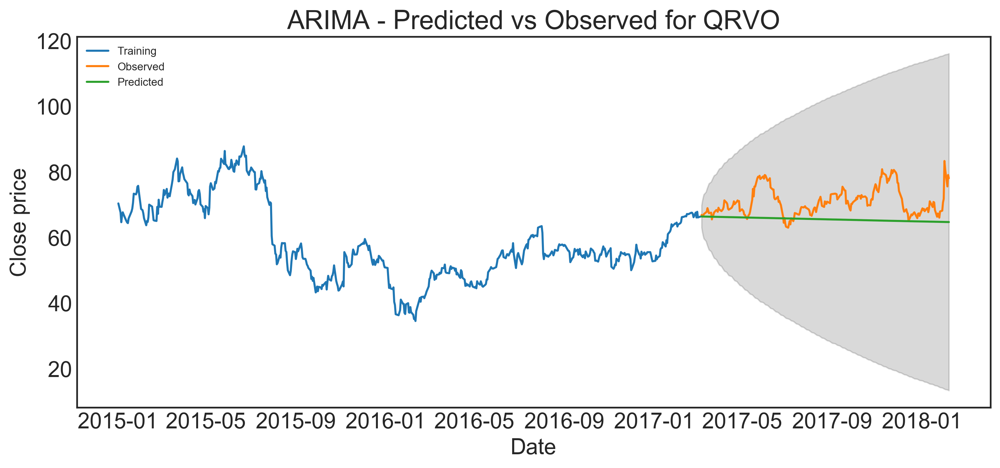

In [54]:
fc = print_forecast('QRVO', train_data, test_data, test_size, 0, 1, 0)

In [55]:
errors = print_accuracy(fc, test_data)
errors.update({'model': 'ARIMA', 'stock': 'QRVO-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>SARIMA Modeling</h2><br>
The SARIMA model is very similar to ARIMA but takes into account the seasonal trend of the label that we are trying to predict and adjusts the forecast based a combination of the p, d, q values and the seasonal periodicity. For example for data where each row represents a month periodicity would be 12 for 12 months in a year. 

Let us see how SARIMA performs with AAPL stock.

<h2>SARIMA-AAPL-Close price</h2>

In [56]:
drop_columns = ['open', 'high', 'low', 'Name', 'volume']
stock_df = stock_data_copy[stock_data_copy.Name == 'AAPL']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)
# First, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)
stock_df.index = stock_df.date.reset_index(drop=True)
stock_df.drop(columns=['date'], inplace=True)

In [57]:
y = stock_df['close'].resample('MS').mean()

In [58]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 5)
                for x in list(itertools.product(p, d, q))]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 5)
SARIMAX: (0, 0, 1) x (0, 1, 0, 5)
SARIMAX: (0, 1, 0) x (0, 1, 1, 5)
SARIMAX: (0, 1, 0) x (1, 0, 0, 5)


In [59]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        mod = sm.tsa.statespace.SARIMAX(y, order=param,
                                        seasonal_order=param_seasonal,
                                        enforce_stationarity=False,
                                        enforce_invertibility=False)
        results = mod.fit()
        print('ARIMA{}x{}5 - AIC:{}'.format(param, param_seasonal, results.aic))

ARIMA(0, 0, 0)x(0, 0, 0, 5)5 - AIC:741.0290817777002
ARIMA(0, 0, 0)x(0, 0, 1, 5)5 - AIC:627.6373711277622
ARIMA(0, 0, 0)x(0, 1, 0, 5)5 - AIC:467.4729203970584
ARIMA(0, 0, 0)x(0, 1, 1, 5)5 - AIC:410.42341804705336
ARIMA(0, 0, 0)x(1, 0, 0, 5)5 - AIC:458.46346416899485
ARIMA(0, 0, 0)x(1, 0, 1, 5)5 - AIC:442.1344405231328
ARIMA(0, 0, 0)x(1, 1, 0, 5)5 - AIC:420.1446154995495
ARIMA(0, 0, 0)x(1, 1, 1, 5)5 - AIC:409.7134373882648
ARIMA(0, 0, 1)x(0, 0, 0, 5)5 - AIC:655.2023147150267
ARIMA(0, 0, 1)x(0, 0, 1, 5)5 - AIC:555.3353939409885
ARIMA(0, 0, 1)x(0, 1, 0, 5)5 - AIC:414.8520172961168
ARIMA(0, 0, 1)x(0, 1, 1, 5)5 - AIC:373.84708639348645
ARIMA(0, 0, 1)x(1, 0, 0, 5)5 - AIC:419.3494673999316
ARIMA(0, 0, 1)x(1, 0, 1, 5)5 - AIC:404.7768980657408
ARIMA(0, 0, 1)x(1, 1, 0, 5)5 - AIC:390.5141541369933
ARIMA(0, 0, 1)x(1, 1, 1, 5)5 - AIC:375.62532485094147
ARIMA(0, 1, 0)x(0, 0, 0, 5)5 - AIC:386.40094260440105
ARIMA(0, 1, 0)x(0, 0, 1, 5)5 - AIC:354.881825936293
ARIMA(0, 1, 0)x(0, 1, 0, 5)5 - AIC:373.965

In [61]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 0),
                                seasonal_order=(1, 1, 0, 5),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0438      0.156      0.280      0.779      -0.263       0.350
ar.S.L5       -0.3457      0.142     -2.439      0.015      -0.623      -0.068
sigma2        53.6322     13.479      3.979      0.000      27.214      80.050


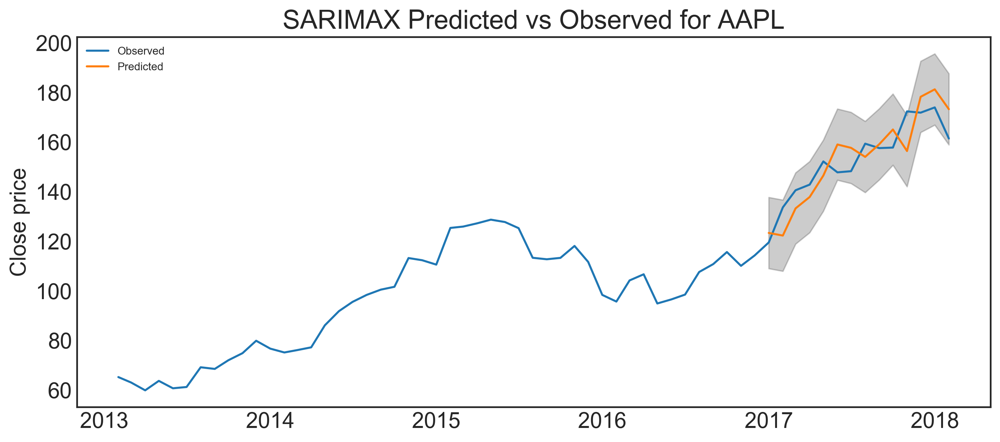

In [62]:
fc = results.get_prediction(start='2017-01-01', dynamic=False)
fc_ci = fc.conf_int()

plt.figure(figsize=(12, 5), dpi=300)
plt.plot(y, label='Observed')
plt.plot(fc.predicted_mean, label='Predicted')
plt.fill_between(fc_ci.index,
                 fc_ci.iloc[:, 0],
                 fc_ci.iloc[:, 1], color='k', alpha=.2)
plt.title('SARIMAX Predicted vs Observed for AAPL')
plt.ylabel('Close price')
plt.legend(loc='upper left', fontsize=8)
filename = 'SARIMAX_forecast_AAPL.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

In [63]:
errors = print_accuracy(fc.predicted_mean, y['2017-01-01':])
errors.update({'model': 'SARIMA', 'stock': 'AAPL-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>SARIMA-AAPL-SMA</h2>

In [64]:
drop_columns = ['open', 'high', 'low', 'Name', 'volume']
stock_df = stock_data_copy[stock_data_copy.Name == 'AAPL']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)
# First, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)
stock_df.index = stock_df.date.reset_index(drop=True)
stock_df.drop(columns=['date'], inplace=True)

In [65]:
y = aapl_sma['close'].resample('MS').mean()

In [66]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12)
                for x in list(itertools.product(p, d, q))]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [67]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        mod = sm.tsa.statespace.SARIMAX(y, order=param,
                                        seasonal_order=param_seasonal,
                                        enforce_stationarity=False,
                                        enforce_invertibility=False)
        results = mod.fit()
        print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:728.281318001441
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:559.8195855314244
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:467.695459584757
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1527.5506385309084
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:460.8285672476678
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:425.17012820733135
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:361.4151296309418
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:1436.9041748033335
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:643.6689994700182
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:491.0857613210002
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:401.7287143719268
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:2577.2496570460376
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:402.89077159830197
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:363.42664702370206
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:317.47419492048107
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:nan
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:351.319454587661
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:287.647832071077
ARIMA(0, 1, 0)x(0, 1,

In [67]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0504      0.302     -0.167      0.867      -0.642       0.541
ma.L1          0.7024      0.220      3.193      0.001       0.271       1.134
ar.S.L12      -0.6234      0.168     -3.710      0.000      -0.953      -0.294
sigma2        28.2849      9.545      2.963      0.003       9.577      46.993


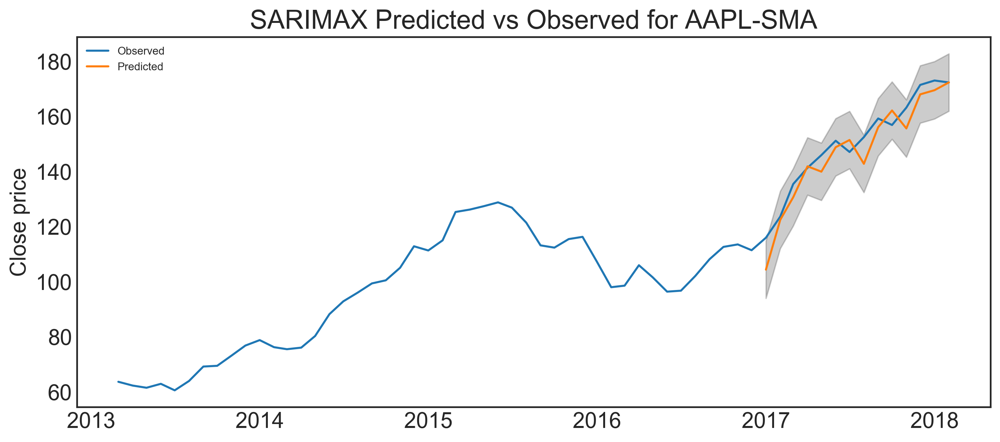

In [68]:
fc = results.get_prediction(start='2017-01-01', dynamic=False)
fc_ci = fc.conf_int()

plt.figure(figsize=(12, 5), dpi=300)
plt.plot(y, label='Observed')
plt.plot(fc.predicted_mean, label='Predicted')
plt.fill_between(fc_ci.index,
                fc_ci.iloc[:, 0],
                fc_ci.iloc[:, 1], color='k', alpha=.2)
plt.title('SARIMAX Predicted vs Observed for AAPL-SMA')
plt.ylabel('Close price')
plt.legend(loc='upper left', fontsize=8)
filename = 'SARIMAX_forecast_AAPL-SMA.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

In [69]:
errors = print_accuracy(fc.predicted_mean, y['2017-01-01':])
errors.update({'model': 'SARIMA', 'stock': 'AAPL-SMA'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>SARIMA-FDX-Close price</h2>

In [70]:
drop_columns = ['open', 'high', 'low', 'Name', 'volume']
stock_df = stock_data_copy[stock_data_copy.Name == 'FDX']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)
# First, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)
stock_df.index = stock_df.date.reset_index(drop=True)
stock_df.drop(columns=['date'], inplace=True)

In [71]:
y = stock_df['close'].resample('MS').mean()

In [72]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12)
                for x in list(itertools.product(p, d, q))]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMA: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMA: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMA: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMA: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMA: (0, 0, 1) x (0, 0, 1, 12)
SARIMA: (0, 0, 1) x (0, 1, 0, 12)
SARIMA: (0, 1, 0) x (0, 1, 1, 12)
SARIMA: (0, 1, 0) x (1, 0, 0, 12)


In [73]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        mod = sm.tsa.statespace.SARIMAX(y, order=param,
                                        seasonal_order=param_seasonal,
                                        enforce_stationarity=False,
                                        enforce_invertibility=False)
        results = mod.fit()
        print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:787.4207302204487
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:603.3203319001401
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:487.8794982766117
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:366.8822521607679
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:474.76282244132256
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:449.04919378303794
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:377.11688963206404
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:368.49377172922533
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:700.7982699601168
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:532.86512373387
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:426.0195342209609
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:319.4632685495744
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:425.5841153936578
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:412.899694715158
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:337.1157596178377
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:320.06613802201
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:427.0154742733732
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:347.54078317764294
ARIMA(0, 1

In [74]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 0, 1),
                                seasonal_order=(0, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9736      0.060     16.110      0.000       0.855       1.092
ma.L1          0.4984      0.194      2.575      0.010       0.119       0.878
ma.S.L12      -1.0001   2581.604     -0.000      1.000   -5060.851    5058.851
sigma2        87.4569   2.26e+05      0.000      1.000   -4.42e+05    4.43e+05


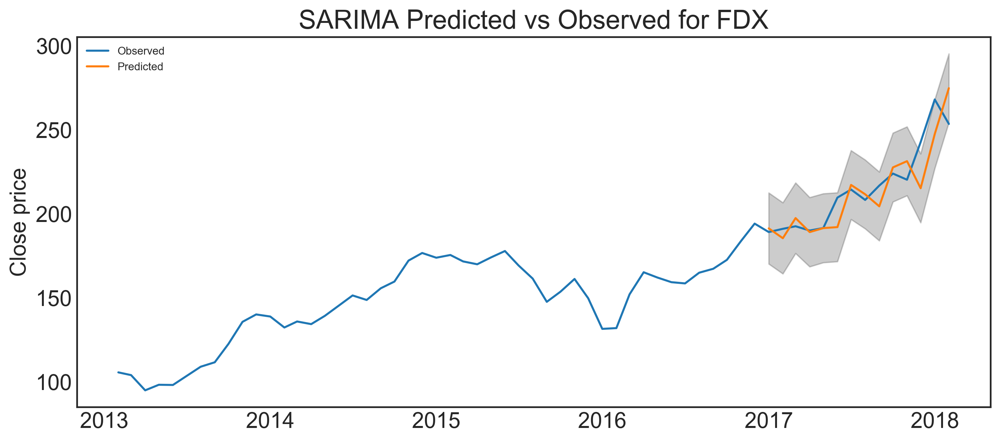

In [75]:
fc = results.get_prediction(start='2017-01-01', dynamic=False)
fc_ci = fc.conf_int()

plt.figure(figsize=(12, 5), dpi=300)
plt.plot(y, label='Observed')
plt.plot(fc.predicted_mean, label='Predicted')
plt.fill_between(fc_ci.index,
                fc_ci.iloc[:, 0],
                fc_ci.iloc[:, 1], color='k', alpha=.2)
plt.title('SARIMA Predicted vs Observed for FDX')
plt.ylabel('Close price')
plt.legend(loc='upper left', fontsize=8)
filename = 'SARIMA_forecast_FDX.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

In [76]:
errors = print_accuracy(fc.predicted_mean, y['2017-01-01':])
errors.update({'model': 'SARIMA', 'stock': 'FDX-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>SARIMA-QRVO-Closing Price</h2>

In [77]:
drop_columns = ['open', 'high', 'low', 'Name', 'volume']
stock_df = stock_data_copy[stock_data_copy.Name == 'QRVO']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)
# First, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)
stock_df.index = stock_df.date.reset_index(drop=True)
stock_df.drop(columns=['date'], inplace=True)

In [78]:
y = stock_df['close'].resample('MS').mean()

In [79]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 5)
                for x in list(itertools.product(p, d, q))]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMA: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMA: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMA: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMA: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMA: (0, 0, 1) x (0, 0, 1, 5)
SARIMA: (0, 0, 1) x (0, 1, 0, 5)
SARIMA: (0, 1, 0) x (0, 1, 1, 5)
SARIMA: (0, 1, 0) x (1, 0, 0, 5)


In [80]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        mod = sm.tsa.statespace.SARIMAX(y, order=param,
                                        seasonal_order=param_seasonal,
                                        enforce_stationarity=False,
                                        enforce_invertibility=False)
        results = mod.fit()
        print('ARIMA{}x{}5 - AIC:{}'.format(param, param_seasonal, results.aic))

ARIMA(0, 0, 0)x(0, 0, 0, 5)5 - AIC:414.01414603408136
ARIMA(0, 0, 0)x(0, 0, 1, 5)5 - AIC:330.98084191287967
ARIMA(0, 0, 0)x(0, 1, 0, 5)5 - AIC:257.57146098358623
ARIMA(0, 0, 0)x(0, 1, 1, 5)5 - AIC:204.29078190768993
ARIMA(0, 0, 0)x(1, 0, 0, 5)5 - AIC:267.3423987077448
ARIMA(0, 0, 0)x(1, 0, 1, 5)5 - AIC:261.2785855468637
ARIMA(0, 0, 0)x(1, 1, 0, 5)5 - AIC:219.11434938529484
ARIMA(0, 0, 0)x(1, 1, 1, 5)5 - AIC:206.29042890836746
ARIMA(0, 0, 1)x(0, 0, 0, 5)5 - AIC:360.58858670544976
ARIMA(0, 0, 1)x(0, 0, 1, 5)5 - AIC:287.30592765320034
ARIMA(0, 0, 1)x(0, 1, 0, 5)5 - AIC:229.60562211967692
ARIMA(0, 0, 1)x(0, 1, 1, 5)5 - AIC:177.0789394403846
ARIMA(0, 0, 1)x(1, 0, 0, 5)5 - AIC:245.77014034177452
ARIMA(0, 0, 1)x(1, 0, 1, 5)5 - AIC:228.45937708678858
ARIMA(0, 0, 1)x(1, 1, 0, 5)5 - AIC:193.45094545839112
ARIMA(0, 0, 1)x(1, 1, 1, 5)5 - AIC:175.70984181482245
ARIMA(0, 1, 0)x(0, 0, 0, 5)5 - AIC:237.08012036973764
ARIMA(0, 1, 0)x(0, 0, 1, 5)5 - AIC:205.48206642810499
ARIMA(0, 1, 0)x(0, 1, 0, 5)5 - 

In [81]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(0, 1, 1),
                                seasonal_order=(0, 1, 1, 5),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.5439      0.179      3.037      0.002       0.193       0.895
ma.S.L5       -0.6798      0.245     -2.770      0.006      -1.161      -0.199
sigma2        34.8643     10.102      3.451      0.001      15.064      54.664


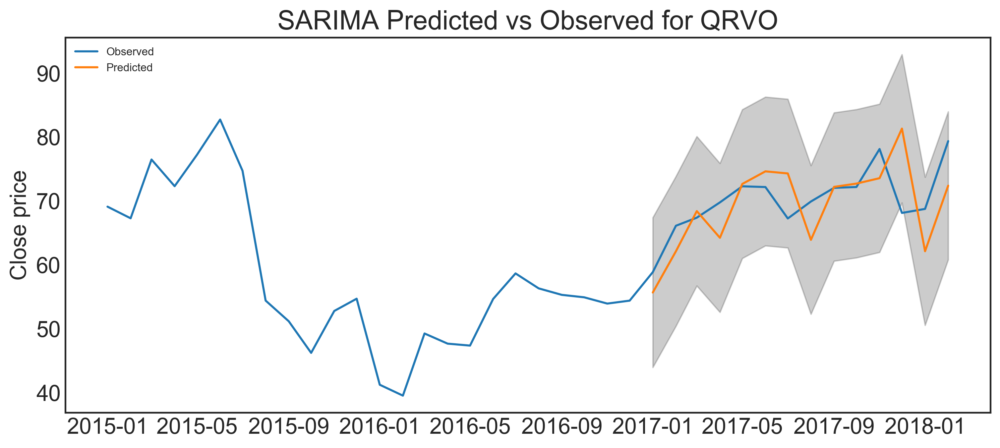

In [82]:
fc = results.get_prediction(start='2017-01-01', dynamic=False)
fc_ci = fc.conf_int()

plt.figure(figsize=(12, 5), dpi=300)
plt.plot(y, label='Observed')
plt.plot(fc.predicted_mean, label='Predicted')
plt.fill_between(fc_ci.index,
                fc_ci.iloc[:, 0],
                fc_ci.iloc[:, 1], color='k', alpha=.2)
plt.title('SARIMA Predicted vs Observed for QRVO')
plt.ylabel('Close price')
plt.legend(loc='upper left', fontsize=8)
filename = 'SARIMA_forecast_QRVO.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

In [83]:
errors = print_accuracy(fc.predicted_mean, y['2017-01-01':])
errors.update({'model': 'SARIMA', 'stock': 'QRVO-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>Linear Regression model</h2><br>
Below we will try a Linear Regression model to predict AAPL stock and extend the model to FDX and QRVO.

<h2>Linear Regression-AAPL-Close price</h2>

In [84]:
# Remember that we made a copy of our original data
# We are restoring data from the copied dataframe for Linear Regression model

stock_data_copy.head()

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL


In [85]:
# We are predicting the daily 'close' value and can drop the open, high and low values of the stock.

drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'AAPL']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)

In [86]:
# First, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)

# Then convert the datetime type to UTC time in nanoseconds
stock_df.date = pd.to_numeric(stock_df.date)

In [87]:
stock_df.drop(columns=['Name'], inplace=True)

In [88]:
# Instantiate and fit our model.

# Our features are the date and volume columns
# The label will the 'close' value

from sklearn import linear_model

regr = linear_model.LinearRegression()
Y = stock_df['close'].values.reshape(-1, 1)
X = stock_df[['date','volume']]
regr.fit(X, Y)

# Inspect the results.
print('\nCoefficients: \n', regr.coef_)
print('\nIntercept: \n', regr.intercept_)
print('\nR-squared:')
print(regr.score(X, Y))


Coefficients: 
 [[ 5.73357340e-16 -3.52985637e-08]]

Intercept: 
 [-714.14349538]

R-squared:
0.7766464157735372


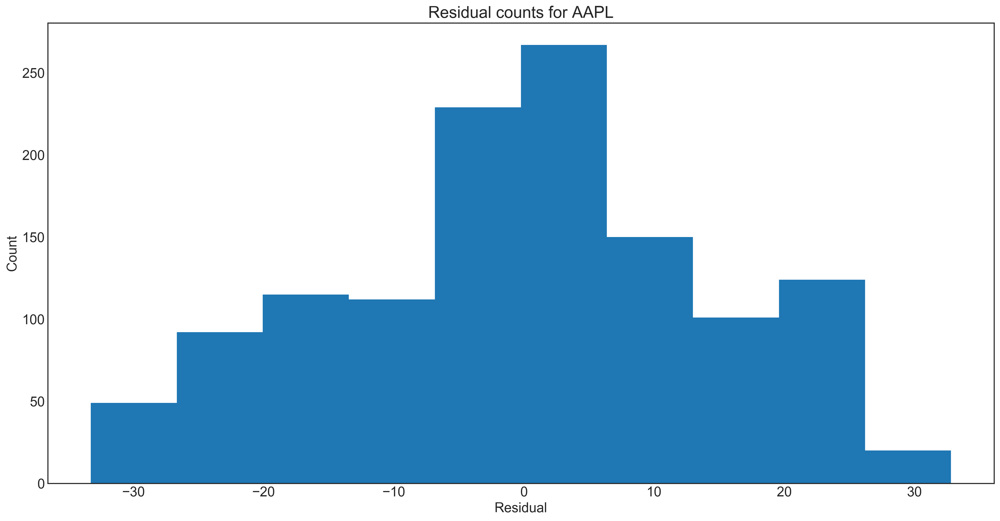

In [89]:
# Extract predicted values.
predicted = regr.predict(X).ravel()
actual = stock_df['close']

# Calculate the error, also called the residual.
residual = actual - predicted

# Plot the residual value to see if it has a normal distribution
plt.hist(residual)
plt.title('Residual counts for AAPL')
plt.xlabel('Residual')
plt.ylabel('Count')
plt.show()

In [90]:
errors = print_accuracy(predicted, actual)
errors.update({'model': 'Lin Reg', 'stock': 'AAPL-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

In [91]:
drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'AAPL']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)

stock_df.date = pd.to_datetime(stock_df.date)

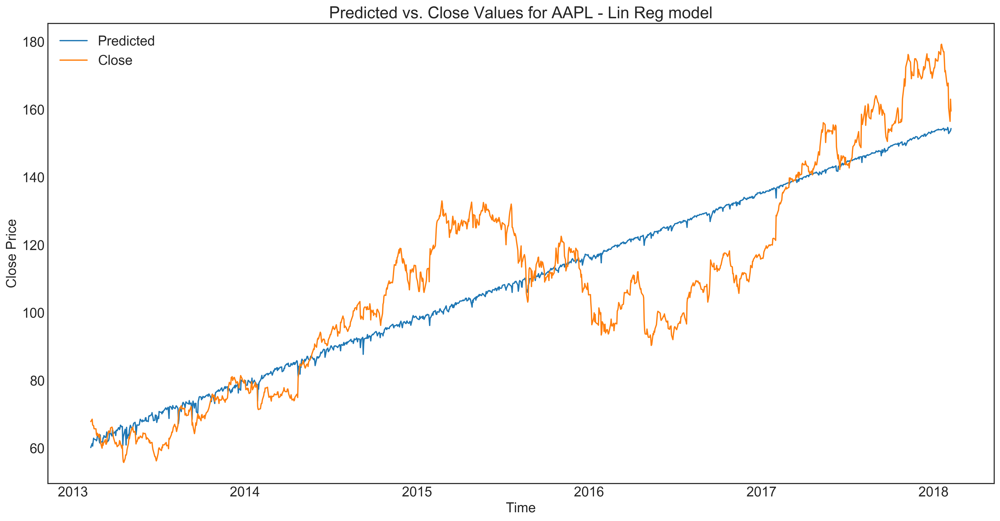

In [92]:
#plt.legend(labels=['Close','Predicted'], loc='best')
plt.title('Predicted vs. Close Values for AAPL - Lin Reg model')
plt.xlabel('Time')
plt.ylabel('Close Price')
p2, = plt.plot(stock_df.date, predicted)
p1, = plt.plot(stock_df.date, stock_df.close)
plt.legend([p2, p1], labels=['Predicted','Close'], loc='best')
filename = 'Lin_reg_AAPL_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>Observations from the Linear Regression model</h2><br>
The Linear Regression model did not perform well at all. Linear Regression, as the name suggests, expects the relationship between the features to be linear. In our case stock market prices are hardly linear. Adding more features could have made a difference. But in the case of stock prices apart from volume and price there are other human factors that affect the prices which cannot be captured as a numerical value for modeling.<br>
<br>Having said that we want to try Linear Regression with FDX and QRVO also just make sure AAPL is not an anomaly.

<h2>Linear Regression-FDX-Close Price</h2>

In [93]:
drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'FDX']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)

In [94]:
stock_df.date = pd.to_numeric(stock_df.date.str.replace("-",""))

In [95]:
stock_df.drop(columns=['Name'], inplace=True)

In [96]:
# Instantiate and fit our model.

from sklearn import linear_model

regr = linear_model.LinearRegression()
Y = stock_df['close'].values.reshape(-1, 1)
X = stock_df[['date','volume']]
regr.fit(X, Y)

# Inspect the results.
print('\nCoefficients: \n', regr.coef_)
print('\nIntercept: \n', regr.intercept_)
print('\nR-squared:')
print(regr.score(X, Y))


Coefficients: 
 [[ 2.14889762e-03 -1.93661852e-06]]

Intercept: 
 [-43138.0379325]

R-squared:
0.7370275980025801


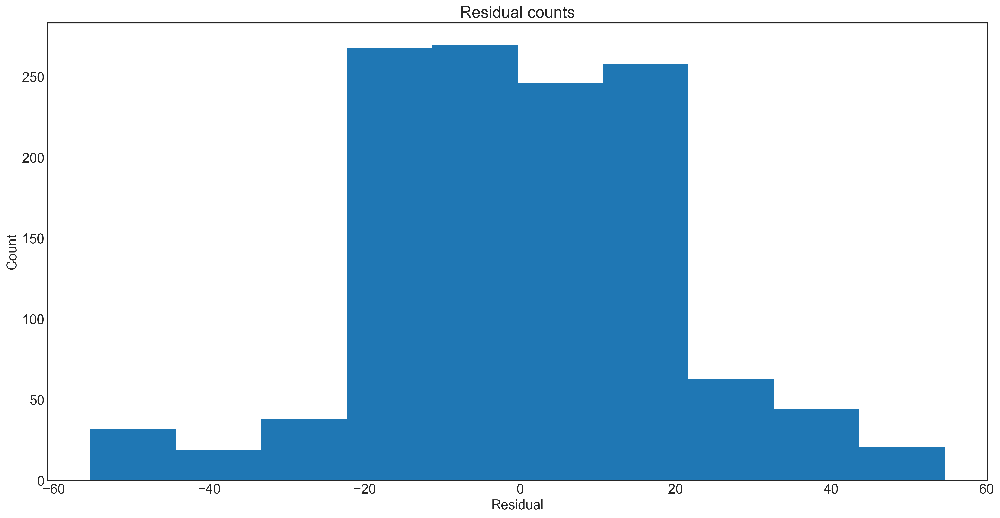

In [97]:
# Extract predicted values.
predicted = regr.predict(X).ravel()
actual = stock_df['close']

# Calculate the error, also called the residual.
residual = actual - predicted

# This looks a bit concerning.
plt.hist(residual)
plt.title('Residual counts')
plt.xlabel('Residual')
plt.ylabel('Count')
plt.show()

In [98]:
errors = print_accuracy(predicted, actual)
errors.update({'model': 'Lin Reg', 'stock': 'FDX-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

In [99]:
drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'FDX']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)

stock_df.date = pd.to_datetime(stock_df.date)

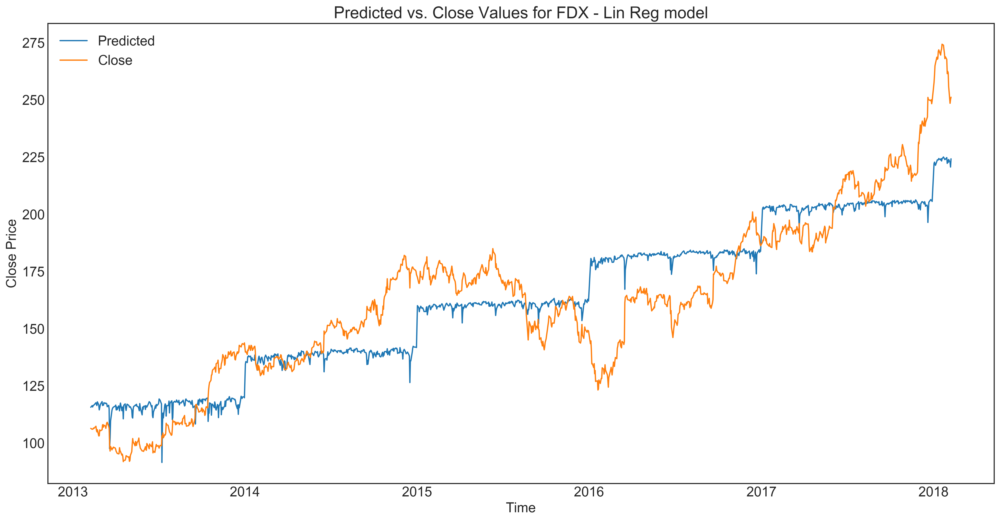

In [100]:
p1, = plt.plot(stock_df.date, predicted)
p2, = plt.plot(stock_df.date, stock_df.close)
plt.title('Predicted vs. Close Values for FDX - Lin Reg model')
plt.xlabel('Time')
plt.ylabel('Close Price')
plt.legend([p2, p1], labels=['Predicted','Close'], loc='best')
filename = 'Lin_reg_FDX_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>Linear Regression-QRVO-Closing price</h2>

In [101]:
drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'QRVO']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)

In [102]:
stock_df.date = pd.to_numeric(stock_df.date.str.replace("-",""))

In [103]:
stock_df.drop(columns=['Name'], inplace=True)

In [104]:
# Instantiate and fit our model.

from sklearn import linear_model

regr = linear_model.LinearRegression()
Y = stock_df['close'].values.reshape(-1, 1)
X = stock_df[['date','volume']]
regr.fit(X, Y)

# Inspect the results.
print('\nCoefficients: \n', regr.coef_)
print('\nIntercept: \n', regr.intercept_)
print('\nR-squared:')
print(regr.score(X, Y))


Coefficients: 
 [[2.77635960e-04 5.63339539e-07]]

Intercept: 
 [-5536.3047109]

R-squared:
0.04675989887280285


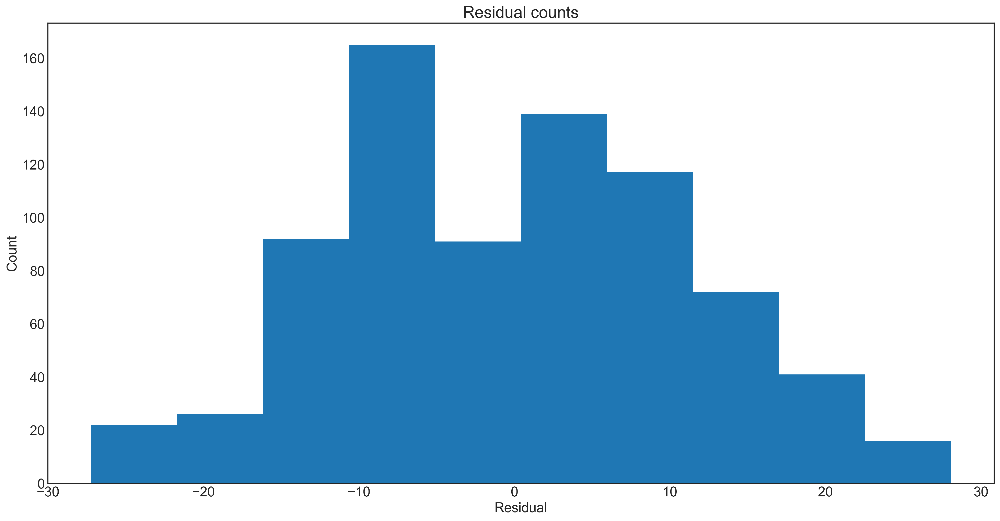

In [105]:
# Extract predicted values.
predicted = regr.predict(X).ravel()
actual = stock_df['close']

# Calculate the error, also called the residual.
residual = actual - predicted

# This looks a bit concerning.
plt.hist(residual)
plt.title('Residual counts')
plt.xlabel('Residual')
plt.ylabel('Count')
plt.show()

In [106]:
errors = print_accuracy(predicted, actual)
errors.update({'model': 'Lin Reg', 'stock': 'QRVO-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

In [107]:
drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'QRVO']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)

stock_df.date = pd.to_datetime(stock_df.date)

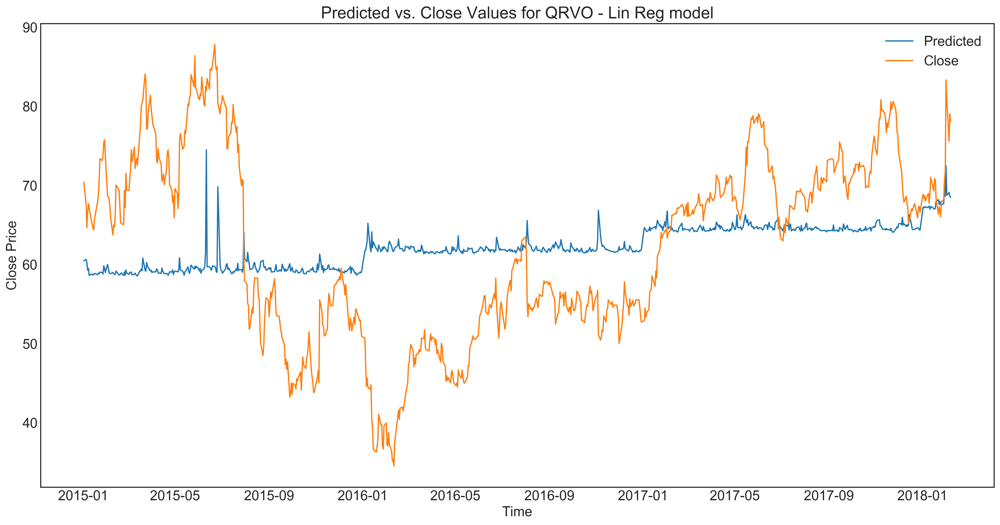

In [108]:
p2, = plt.plot(stock_df.date, predicted)
p1, = plt.plot(stock_df.date, stock_df.close)
plt.title('Predicted vs. Close Values for QRVO - Lin Reg model')
plt.xlabel('Time')
plt.ylabel('Close Price')
plt.legend([p2, p1], labels=['Predicted','Close'], loc='best')
filename = 'Lin_reg_QRVO_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>LSTM model</h2><br>
LSTM or Long Short Term Memory is supposedly a good choice for many time series based forecasting problem. LSTM models use past history of the data that is very much needed for stock predictions. LSTM is a recurring neural network (RNN) with an ability to remember the recent past. Let us try a LSTM model on our stock data see how it performs.

In [109]:
stock_data_copy.head()

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL


In [116]:
from sklearn.preprocessing import MinMaxScaler
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # or any {'0', '1', '2'}
from keras.models import Sequential
from keras.layers import Dense, Dropout, LSTM
import tensorflow as tf

In [117]:
stock_data_copy.head()

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL


<h2>LSTM-AAPL-Close price</h2>

In [118]:
# Creating dataframe from our back up copy

stock_df = pd.DataFrame(columns=['date', 'close'])
stock_df['close'] = stock_data_copy.close[stock_data_copy.Name == 'AAPL']

stock_df['date'] = pd.to_datetime(stock_data_copy.date)
stock_df.index = stock_df.date
stock_df.drop('date', axis=1, inplace=True)

In [119]:
stock_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1259 entries, 2013-02-08 to 2018-02-07
Data columns (total 1 columns):
close    1259 non-null float64
dtypes: float64(1)
memory usage: 19.7 KB


In [120]:
lstm_inputs = stock_df.values
train_size = int(round(lstm_inputs.shape[0]*0.70, 0))
train_data = lstm_inputs[:train_size]
test_data = lstm_inputs[train_size:]
test_size = test_data.shape

In [121]:
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(lstm_inputs)

In [122]:
x_train, y_train = [], []

#    - The dataset is of 1259 rows
#    - We split train_data as the first 881 rows (or 70% of 1259)
#    - The remainder of 30% or 378 rows is now test_data
#    - We scale all the 1259 rows of 'close' value using MinMaxScaler
#    

# From the train_data we split rows 0 to 681 as x_train
# And rows 200 to 881 (also 681 rows) as y_train
# x_train and y_train are used to fit the LSTM model

for i in range(200,len(train_data)):
    x_train.append(scaled_data[i-200:i,0])
    y_train.append(scaled_data[i,0])
x_train, y_train = np.array(x_train), np.array(y_train)

x_train = np.reshape(x_train, (x_train.shape[0],x_train.shape[1],1))

# create and fit the LSTM network
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(x_train.shape[1],1)))
model.add(LSTM(units=50))
model.add(Dense(1))

model.compile(loss='mean_squared_error', optimizer='adam')

model.fit(x_train, y_train, epochs=1, batch_size=1, verbose=2)

# Here we take the data from row 681 to 1259 (or 578 values) from our dataset... 
# ...scale them and pass the last 378 values to predict/forecast function

inputs = stock_df[len(stock_df) - len(test_data) - 200:].values
inputs = inputs.reshape(-1,1)
inputs  = scaler.transform(inputs)

X_test = []
for i in range(200,inputs.shape[0]):
    X_test.append(inputs[i-200:i,0])
X_test = np.array(X_test)

X_test = np.reshape(X_test, (X_test.shape[0],X_test.shape[1],1))
closing_price = model.predict(X_test)
closing_price = scaler.inverse_transform(closing_price)

W0731 08:07:56.495151 4555900352 deprecation_wrapper.py:119] From /usr/local/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0731 08:07:56.523360 4555900352 deprecation_wrapper.py:119] From /usr/local/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0731 08:07:56.533129 4555900352 deprecation_wrapper.py:119] From /usr/local/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0731 08:07:56.926331 4555900352 deprecation_wrapper.py:119] From /usr/local/lib/python3.7/site-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0731 08:07:57.148628 4555900352 deprecation.py:323] From /usr/local/lib/pyt

Epoch 1/1
 - 150s - loss: 0.0019


In [123]:
errors = print_accuracy(closing_price, test_data)
errors.update({'model': 'LSTM', 'stock': 'AAPL-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

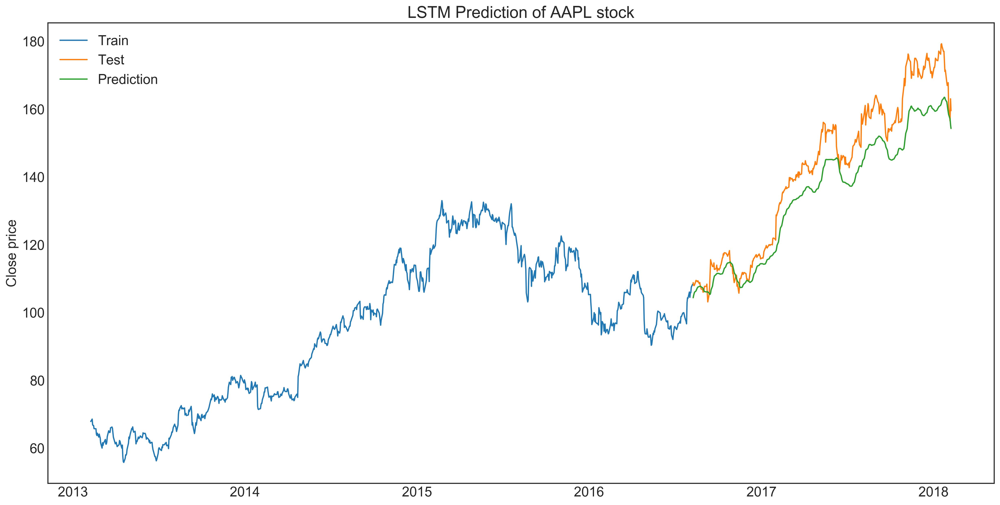

In [124]:
#for plotting
train_size = int(round(stock_df.shape[0]*0.70, 0))
train_data = stock_df[:train_size]
test_data = stock_df[train_size:]
test_data['Predictions'] = closing_price

p1, = plt.plot(train_data['close'])
plt.title('LSTM Prediction of AAPL stock')
plt.ylabel('Close price')
p2, p3 = plt.plot(test_data[['close','Predictions']])
plt.legend([p3, p2, p1], labels=['Train','Test', 'Prediction'], loc='best')
filename = 'LSTM_AAPL_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>LSTM-FDX-Close</h2>

In [125]:
# Creating dataframe from our back up copy
# Creating dataframe from our back up copy

stock_df = pd.DataFrame(columns=['date', 'close'])
stock_df['close'] = stock_data_copy.close[stock_data_copy.Name == 'FDX']

stock_df['date'] = pd.to_datetime(stock_data_copy.date)
stock_df.index = stock_df.date
stock_df.drop('date', axis=1, inplace=True)

In [126]:
lstm_inputs = stock_df.values
train_size = int(round(lstm_inputs.shape[0]*0.70, 0))
train_data = lstm_inputs[:train_size]
test_data = lstm_inputs[train_size:]
test_size = test_data.shape

In [127]:
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(lstm_inputs)

In [128]:
x_train, y_train = [], []

#    - The dataset is of 1259 rows
#    - We split train_data as the first 881 rows (or 70% of 1259)
#    - The remainder of 30% or 378 rows is now test_data
#    - We scale all the 1259 rows of 'close' value using MinMaxScaler
#    

# From the train_data we split rows 0 to 681 as x_train
# And rows 200 to 881 (also 681 rows) as y_train
# x_train and y_train are used to fit the LSTM model

for i in range(200,len(train_data)):
    x_train.append(scaled_data[i-200:i,0])
    y_train.append(scaled_data[i,0])
x_train, y_train = np.array(x_train), np.array(y_train)

x_train = np.reshape(x_train, (x_train.shape[0],x_train.shape[1],1))

# create and fit the LSTM network
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(x_train.shape[1],1)))
model.add(LSTM(units=50))
model.add(Dense(1))

model.compile(loss='mean_squared_error', optimizer='adam')

model.fit(x_train, y_train, epochs=1, batch_size=1, verbose=2)

# Here we take the data from row 681 to 1259 (or 578 values) from our dataset... 
# ...scale them and pass the last 378 values to predict/forecast function

inputs = stock_df[len(stock_df) - len(test_data) - 200:].values
inputs = inputs.reshape(-1,1)
inputs  = scaler.transform(inputs)

X_test = []
for i in range(200,inputs.shape[0]):
    X_test.append(inputs[i-200:i,0])
X_test = np.array(X_test)

X_test = np.reshape(X_test, (X_test.shape[0],X_test.shape[1],1))
closing_price = model.predict(X_test)
closing_price = scaler.inverse_transform(closing_price)

Epoch 1/1
 - 149s - loss: 0.0024


In [130]:
errors = print_accuracy(closing_price, test_data)
errors.update({'model': 'LSTM', 'stock': 'FDX-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

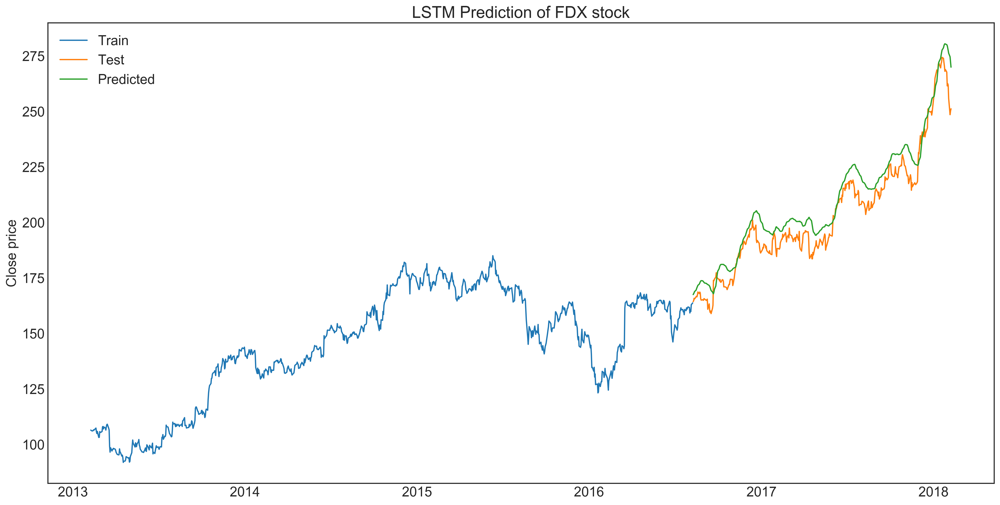

In [131]:
#for plotting
train_size = int(round(stock_df.shape[0]*0.70, 0))
train_data = stock_df[:train_size]
test_data = stock_df[train_size:]
test_data['Predictions'] = closing_price
p1, = plt.plot(train_data['close'])
plt.title('LSTM Prediction of FDX stock')
plt.ylabel('Close price')
p2, p3 = plt.plot(test_data[['close','Predictions']])
plt.legend([p3, p2, p1], labels=['Train','Test', 'Predicted'], loc='best')
filename = 'LSTM_FDX_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>LSTM-QRVO-Close</h2>

In [132]:
# Creating dataframe from our back up copy

stock_df = pd.DataFrame(columns=['date', 'close'])
stock_df['close'] = stock_data_copy.close[stock_data_copy.Name == 'QRVO']

stock_df['date'] = pd.to_datetime(stock_data_copy.date)
stock_df.index = stock_df.date
stock_df.drop('date', axis=1, inplace=True)

In [133]:
lstm_inputs = stock_df.values
train_size = int(round(lstm_inputs.shape[0]*0.70, 0))
train_data = lstm_inputs[:train_size]
test_data = lstm_inputs[train_size:]
test_size = test_data.shape

In [134]:
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(lstm_inputs)

In [135]:
x_train, y_train = [], []
#
#    - The dataset has 781 rows
#    - We split train_data as the first 547 rows (or 70% of 781)
#    - The remainder of 30% or 234 rows is now test_data
#    - We scale all the 781 rows of 'close' value using MinMaxScaler
#    
# From the train_data we split rows 0 to 426 as x_train
# And rows 120 to 547 (426 rows) as y_train
# x_train and y_train are used to fit the LSTM model

for i in range(120,len(train_data)):
    x_train.append(scaled_data[i-120:i,0])
    y_train.append(scaled_data[i,0])
x_train, y_train = np.array(x_train), np.array(y_train)

x_train = np.reshape(x_train, (x_train.shape[0],x_train.shape[1],1))

# create and fit the LSTM network
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(x_train.shape[1],1)))
model.add(LSTM(units=50))
model.add(Dense(1))

model.compile(loss='mean_squared_error', optimizer='adam')

model.fit(x_train, y_train, epochs=1, batch_size=1, verbose=2)

# Here we take the data from row 427 to 781 (or 427 values) from our dataset... 
# ...scale them and pass the last 427 values to predict/forecast function

inputs = stock_df[len(stock_df) - len(test_data) - 120:].values
inputs = inputs.reshape(-1,1)
inputs  = scaler.transform(inputs)

X_test = []
for i in range(120,inputs.shape[0]):
    X_test.append(inputs[i-120:i,0])
X_test = np.array(X_test)

X_test = np.reshape(X_test, (X_test.shape[0],X_test.shape[1],1))
closing_price = model.predict(X_test)
closing_price = scaler.inverse_transform(closing_price)

Epoch 1/1
 - 54s - loss: 0.0074


In [136]:
errors = print_accuracy(closing_price, test_data)
errors.update({'model': 'LSTM', 'stock': 'QRVO-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

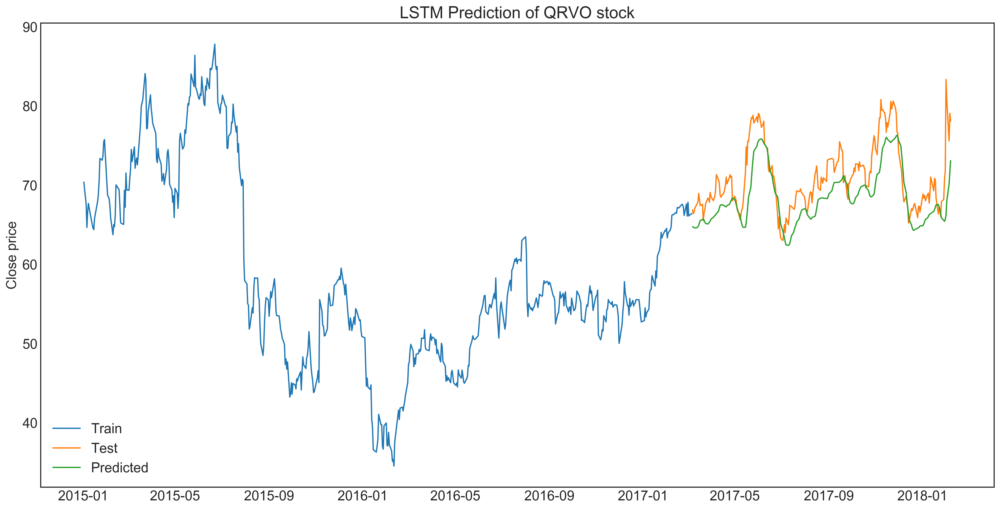

In [137]:
#for plotting
train_size = int(round(stock_df.shape[0]*0.70, 0))
train_data = stock_df[:train_size]
test_data = stock_df[train_size:]
test_data['Predictions'] = closing_price
p1, = plt.plot(train_data['close'])
plt.ylabel('Close price')
plt.title('LSTM Prediction of QRVO stock')
p2, p3, = plt.plot(test_data[['close','Predictions']])
plt.legend([p3, p2, p1], labels=['Train','Test', 'Predicted'], loc='best')
filename = 'LSTM_QRVO_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>Random Forest models</h2>

<h2>Random Forest AAPL Close price</h2>

In [138]:
# Restore data from our backup dataframe
# Drop the unwanted columns

drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'AAPL']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)
stock_df.drop(columns=['Name'], inplace=True)

# RandomForest and other regressors require date to be in integer format
# So, first, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)

# Then convert the datetime type to UTC time in nanoseconds
stock_df.date = pd.to_numeric(stock_df.date)

# Reset the index to start from 0
stock_df = stock_df.dropna().reset_index(drop=True)

train_size = int(round(stock_df.shape[0]*0.70, 0))
train_data = stock_df[:train_size]
test_data = stock_df[train_size:]
test_size = test_data.shape

In [139]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression

stock_df.date = pd.to_numeric(stock_df.date)

# Create an instance of the model
regr = RandomForestRegressor(max_depth=7, random_state=0, n_estimators=100)
Y = train_data['close'].values.reshape(-1, 1)
X = train_data[['date','volume']]

Y_test = test_data['close'].values.reshape(-1, 1)
X_test = test_data[['date','volume']]

# Fit the features and labels
regr.fit(X, Y)

# Print the R-squared value
print('\nR-squared:')
print(regr.score(X, Y))


R-squared:
0.9955250995140319


In [140]:
stock_df.date = pd.to_datetime(stock_df.date)
train_data.date = pd.to_datetime(train_data.date)
test_data.date = pd.to_datetime(test_data.date)

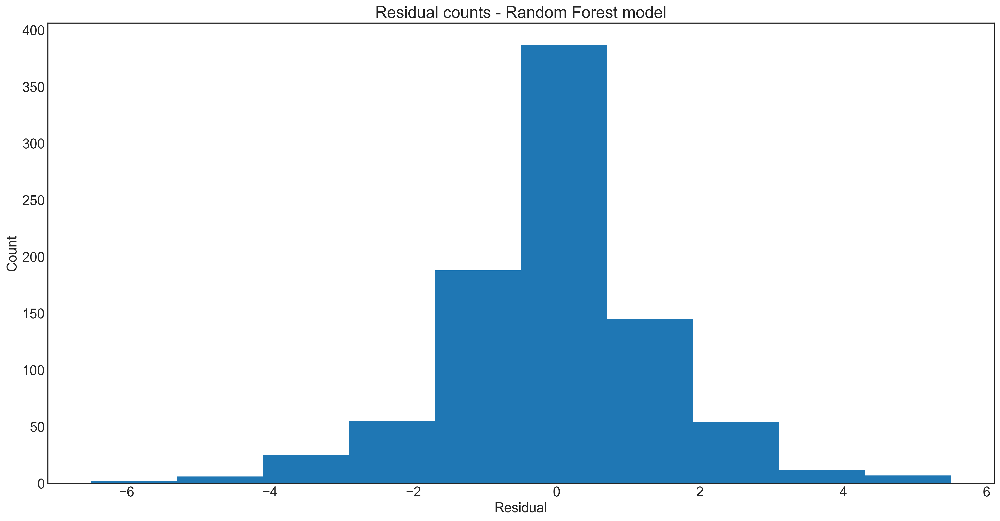

In [141]:
# Extract predicted values.
predicted = regr.predict(X).ravel()
actual = train_data['close']

# Calculate the error, also called the residual.
residual = actual - predicted

# This looks a bit concerning.
plt.hist(residual)
plt.title('Residual counts - Random Forest model')
plt.xlabel('Residual')
plt.ylabel('Count')
plt.show()

In [142]:
errors = print_accuracy(predicted, actual)
errors.update({'model': 'RandomF', 'stock': 'AAPL-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

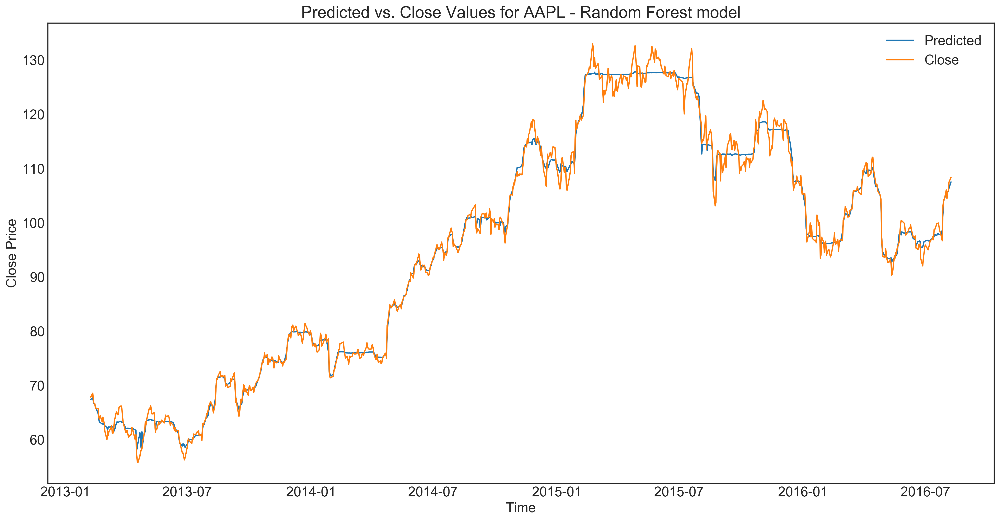

In [143]:
plt.title('Predicted vs. Close Values for AAPL - Random Forest model')
plt.xlabel('Time')
plt.ylabel('Close Price')
p1, = plt.plot(train_data.date, predicted)
p2, = plt.plot(train_data.date, train_data.close)
plt.legend([p2, p1], labels=['Predicted', 'Close'])
filename = 'Random_F_AAPL_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

In [144]:
from sklearn.model_selection import cross_val_score

aapl_train_score = cross_val_score(regr, X, Y, cv=5)
aapl_test_score = cross_val_score(regr, X_test, Y_test, cv=5)

In [145]:
print(aapl_train_score), print(aapl_test_score)

[-6.03775869 -1.80782509  0.07074145  0.64652715 -5.81958457]
[-0.02263264  0.37056862 -0.66754212 -1.69555097 -5.01902371]


(None, None)

<h2>Random Forest AAPL SMA</h2>

In [146]:
# Restore data from our backup dataframe
# Drop the unwanted columns

drop_columns = ['open', 'high', 'low', 'Name']
stock_df = stock_data_copy[stock_data_copy.Name == 'AAPL']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)

# RandomForest and other regressors require date to be in integer format
# So, first, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)

# Then convert the datetime type to UTC time in nanoseconds
stock_df.date = pd.to_numeric(stock_df.date)

# Reset the index to start from 0
stock_df = stock_df.dropna().reset_index(drop=True)

train_size = int(round(stock_df.shape[0]*0.70, 0))
train_data = stock_df[:train_size]
test_data = stock_df[train_size:]
test_size = test_data.shape

In [147]:
aapl_sma = pd.DataFrame(columns=['date', 'volume', 'close'])
aapl_sma['date'] = stock_df['date']
aapl_sma['volume'] = stock_df['volume'].rolling(window=30).mean()
aapl_sma['close'] = stock_df['close'].rolling(window=30).mean()

In [148]:
aapl_sma = aapl_sma[30:]

In [149]:
stock_df = aapl_sma

In [150]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression

stock_df.date = pd.to_numeric(stock_df.date)

# Create an instance of the model
regr = RandomForestRegressor(max_depth=7, random_state=0, n_estimators=100)
Y = stock_df['close'].values.reshape(-1, 1)
X = stock_df[['date','volume']]

# Fit the features and labels
regr.fit(X, Y)

# Print the R-squared value
print('\nR-squared:')
print(regr.score(X, Y))


R-squared:
0.9986442229003474


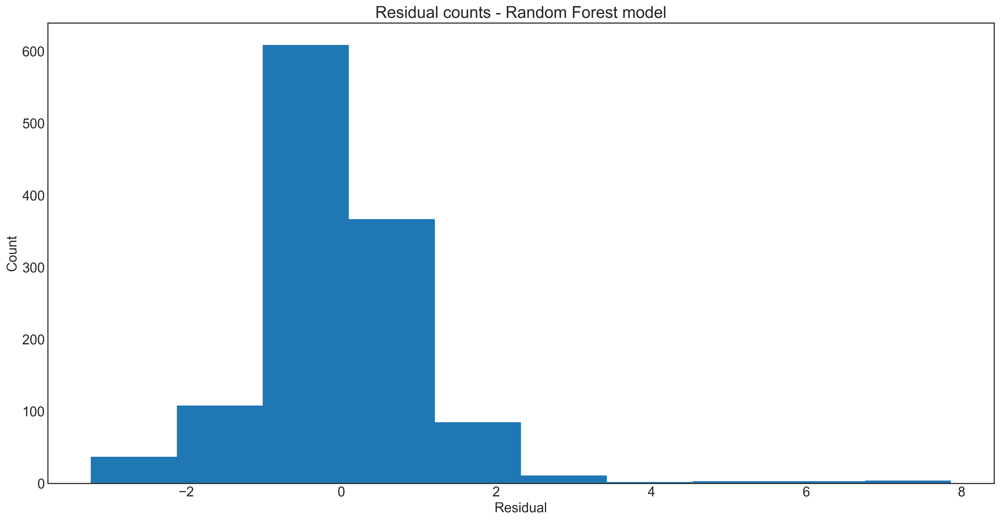

In [151]:
# Extract predicted values.
predicted = regr.predict(X).ravel()
actual = stock_df['close']

# Calculate the error, also called the residual.
residual = actual - predicted

# This looks a bit concerning.
plt.hist(residual)
plt.title('Residual counts - Random Forest model')
plt.xlabel('Residual')
plt.ylabel('Count')
plt.show()

In [152]:
errors = print_accuracy(predicted, actual)
errors.update({'model': 'RandomF', 'stock': 'AAPL-SMA'})
error_stats = error_stats.append(errors, ignore_index=True)

In [153]:
stock_df.date = pd.to_datetime(stock_df.date)
#train_data.date = pd.to_datetime(train_data.date)
#test_data.date = pd.to_datetime(test_data.date)

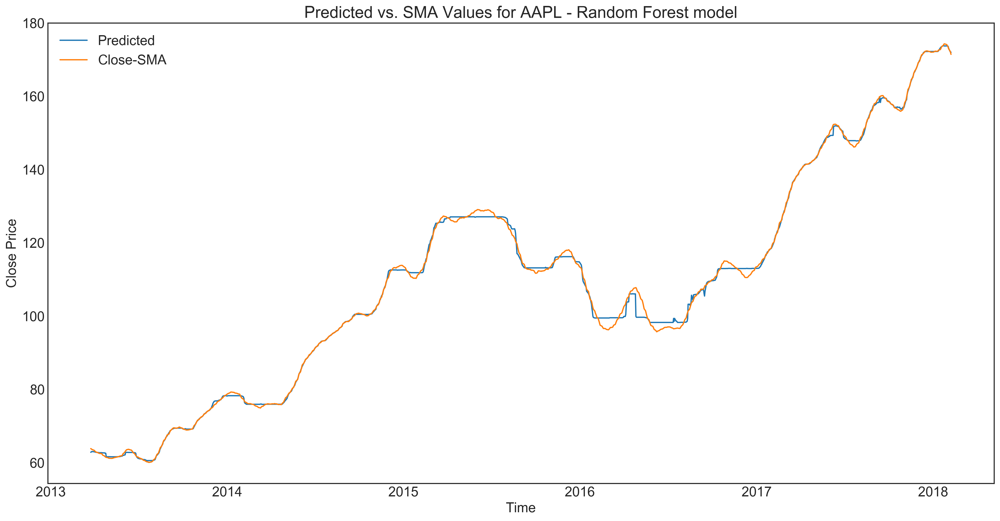

In [154]:
plt.title('Predicted vs. SMA Values for AAPL - Random Forest model')
plt.xlabel('Time')
plt.ylabel('Close Price')
p1, = plt.plot(stock_df.date, predicted)
p2, = plt.plot(stock_df.date, stock_df.close)
plt.legend([p1, p2], labels=['Predicted', 'Close-SMA'])
filename = 'Random_F_AAPL_SMA_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>Random Forest FDX Close</h2>

In [155]:
# Restore the data from the backup dataframe
# Drop the unwanted columns

drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'FDX']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)
stock_df.drop(columns=['Name'], inplace=True)

# RandomForest and other regressors require date to be in numeric format
# First, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)

# Then convert the datetime type to UTC time in nanoseconds
stock_df.date = pd.to_numeric(stock_df.date)

stock_df = stock_df.dropna().reset_index(drop=True)

train_size = int(round(stock_df.shape[0]*0.70, 0))
train_data = stock_df[:train_size]
test_data = stock_df[train_size:]
test_size = test_data.shape

In [156]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression

# Create an instance of the RF regressor model
# Our features are date and volume, and label is the daily close value

regr = RandomForestRegressor(max_depth=7, random_state=0, n_estimators=100)
Y = stock_df['close'].values.reshape(-1, 1)
X = stock_df[['date','volume']]
regr.fit(X, Y)

# Inspect the results.
print('\nR-squared:')
print(regr.score(X, Y))


R-squared:
0.9951025000010009


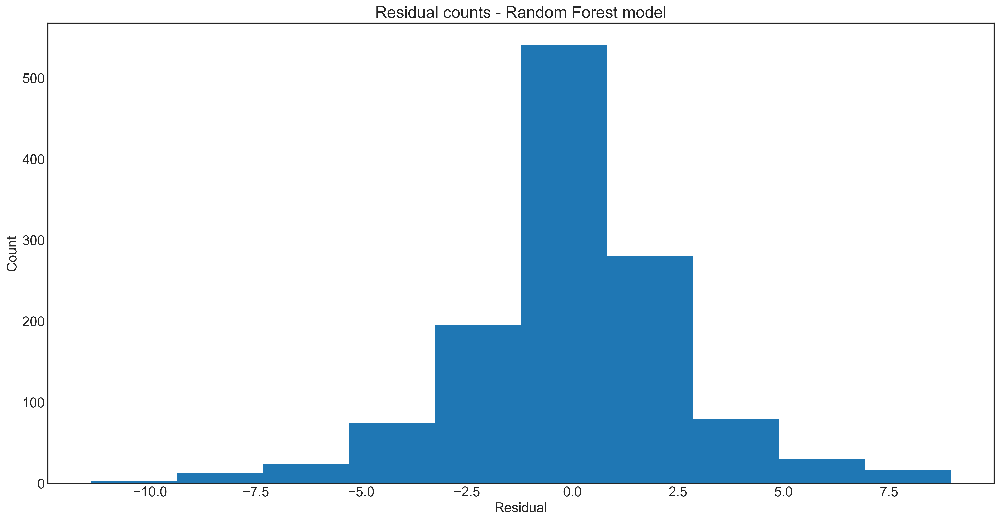

In [157]:
stock_df.date = pd.to_datetime(stock_df.date)

# Extract predicted values.
predicted = regr.predict(X).ravel()
actual = stock_df['close']

# Calculate the error, also called the residual.
residual = actual - predicted

# This looks a bit concerning.
plt.hist(residual)
plt.title('Residual counts - Random Forest model')
plt.xlabel('Residual')
plt.ylabel('Count')
plt.show()

In [158]:
errors = print_accuracy(predicted, actual)
errors.update({'model': 'RandomF', 'stock': 'FDX-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

In [159]:
stock_df.date = pd.to_datetime(stock_df.date)
#train_data.date = pd.to_datetime(train_data.date)
#test_data.date = pd.to_datetime(test_data.date)

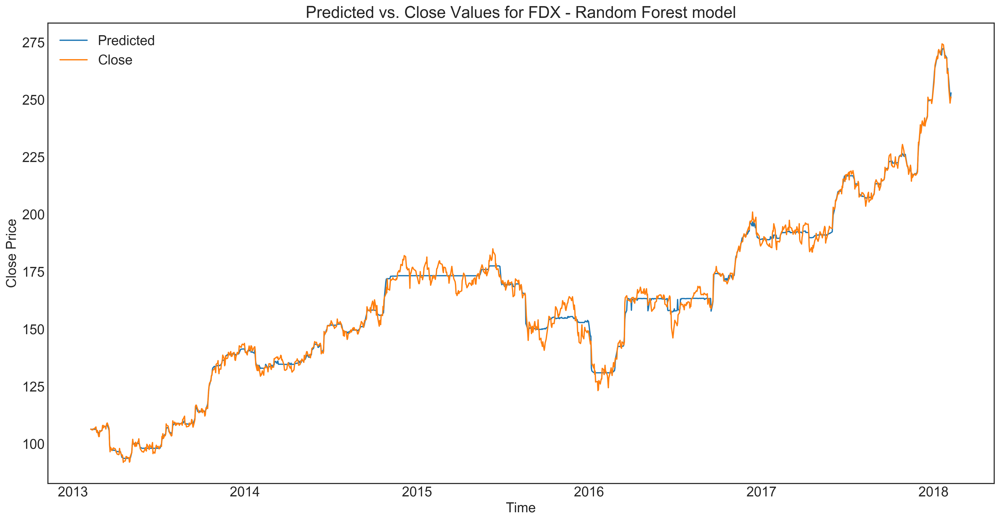

In [160]:
plt.title('Predicted vs. Close Values for FDX - Random Forest model')
plt.xlabel('Time')
plt.ylabel('Close Price')
p1, = plt.plot(stock_df.date, predicted)
p2, = plt.plot(stock_df.date, stock_df.close)
plt.legend([p1, p2], labels=['Predicted', 'Close'])
filename = 'Random_F_FDX_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

<h2>Random Forest QRVO Close</h2>

In [161]:
drop_columns = ['open', 'high', 'low',]
stock_df = stock_data_copy[stock_data_copy.Name == 'QRVO']
stock_df = stock_df.drop(columns=drop_columns).reset_index(drop=True)
stock_df.drop(columns=['Name'], inplace=True)

# First, convert the string to datetime type
stock_df.date = pd.to_datetime(stock_df.date)

# Then convert the datetime type to UTC time in nanoseconds
stock_df.date = pd.to_numeric(stock_df.date)

stock_df = stock_df.dropna().reset_index(drop=True)

train_size = int(round(stock_df.shape[0]*0.70, 0))
train_data = stock_df[:train_size]
test_data = stock_df[train_size:]
test_size = test_data.shape

In [162]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression

stock_df.date = pd.to_numeric(stock_df.date)

regr = RandomForestRegressor(max_depth=7, random_state=0, n_estimators=100)
Y = stock_df['close'].values.reshape(-1, 1)
X = stock_df[['date','volume']]
regr.fit(X, Y)

# Inspect the results.
#print('\nCoefficients: \n', regr.coef_)
#print('\nIntercept: \n', regr.intercept_)
print('\nR-squared:')
print(regr.score(X, Y))


R-squared:
0.9885521402072338


In [ ]:
# PLOT REMOVED TO REDUCE FILE SIZE.

stock_df.date = pd.to_datetime(stock_df.date)

# Extract predicted values.
predicted = regr.predict(X).ravel()
actual = stock_df['close']

# Calculate the error, also called the residual.
residual = actual - predicted

# This looks a bit concerning.
plt.hist(residual)
plt.title('Residual counts - Random Forest model')
plt.xlabel('Residual')
plt.ylabel('Count')
plt.show()

In [164]:
stock_df.date = pd.to_datetime(stock_df.date)
#train_data.date = pd.to_datetime(train_data.date)
#test_data.date = pd.to_datetime(test_data.date)

In [ ]:
plt.title('Predicted vs. Close Values for QRVO - Random Forest model')
plt.xlabel('Time')
plt.ylabel('Close Price')
p1, = plt.plot(stock_df.date, predicted)
p2, = plt.plot(stock_df.date, stock_df.close)           #Plot removed to reduce file size.
plt.legend([p1, p2], labels=['Predicted', 'Close'])
filename = 'Random_F_QRVO_predict_plot.jpeg'
plt.savefig(filename, dpi=300)
plt.show()

In [166]:
errors = print_accuracy(predicted, actual)
errors.update({'model': 'RandomF', 'stock': 'QRVO-Regular'})
error_stats = error_stats.append(errors, ignore_index=True)

<h2>Summarizing all RMSE scores</h2>

In [199]:
aapl_score = error_stats[error_stats['stock'].str.contains('AAPL')]

In [201]:
aapl_score.reset_index(drop=True)

,corr,map,mape,me,model,mpe,rmse,stock
0,0.963203,25.042135,0.161451,-2.462144e+01,ARIMA,-0.157536,30.217304,AAPL-Regular
1,0.956659,18.990972,0.122982,-1.762418e+01,ARIMA,-0.110776,23.538251,AAPL-SMA
2,0.881105,7.821900,0.051098,5.829666e-01,SARIMA,0.003176,8.628676,AAPL-Regular
3,0.969894,4.533489,0.031328,-3.080252e+00,SARIMA,-0.021751,5.560106,AAPL-SMA
4,0.881275,11.519708,0.105534,1.473685e-13,Lin Reg,0.016441,14.435504,AAPL-Regular
5,NaN,7.422994,0.049302,-7.285217e+00,LSTM,-0.048037,8.679361,AAPL-Regular
6,0.997761,1.030981,0.010646,2.301960e-03,RandomF,0.000316,1.444392,AAPL-Regular
7,0.999322,0.665132,0.006296,-1.376451e-02,RandomF,0.000036,1.088828,AAPL-SMA


In [204]:
fdx_score = error_stats[error_stats['stock'].str.contains('FDX')]
fdx_score.reset_index(drop=True)

,corr,map,mape,me,model,mpe,rmse,stock
0,0.923282,27.594356,0.126478,-2.739968e+01,ARIMA,-0.125264,33.741850,FDX-Regular
1,0.868085,9.543503,0.041502,-2.525580e+00,SARIMA,-0.010628,12.828282,FDX-Regular
2,0.858503,15.178976,0.096967,-1.329567e-12,Lin Reg,0.013734,18.864664,FDX-Regular
3,NaN,6.791155,0.033846,6.332506e+00,LSTM,0.031727,7.882816,FDX-Regular
4,0.997549,1.818256,0.011459,-1.381302e-04,RandomF,0.000320,2.574431,FDX-Regular


In [205]:
qrvo_score = error_stats[error_stats['stock'].str.contains('QRVO')]
qrvo_score.reset_index(drop=True)

,corr,map,mape,me,model,mpe,rmse,stock
0,-0.214552,5.550364,0.075213,-5.440626e+00,ARIMA,-0.073499,6.921763,QRVO-Regular
1,0.566324,4.404685,0.063193,-8.639249e-01,SARIMA,-0.011424,5.590368,QRVO-Regular
2,0.216240,9.360540,0.160722,5.585357e-13,Lin Reg,0.036227,11.278469,QRVO-Regular
3,NaN,2.884367,0.039859,-2.565606e+00,LSTM,-0.035174,3.577422,QRVO-Regular
4,0.994293,0.927453,0.015755,-1.273534e-02,RandomF,0.000528,1.235979,QRVO-Regular


The plots figures below have been deliberately removed to reduce the file size.

In [211]:
rmse_bar = pd.DataFrame(columns=['RMSE_Score', 'model', 'stock'])
rmse_bar['stock'] = aapl_score['stock']
rmse_bar['RMSE_Score'] = aapl_score['rmse']
rmse_bar['model'] = aapl_score['model']

In [ ]:
plt.xlabel('Models')
plt.ylabel('RMSE Score')
sns.barplot(y=rmse_bar.RMSE_Score, x=rmse_bar.model+'-'+rmse_bar.stock, data=rmse_bar)
plt.xticks(rotation='vertical')
plt.title('RMSE Scores for AAPL with various models')
filename = 'AAPL_Score_Bar_plot.jpeg'
plt.tight_layout()
plt.savefig(filename, dpi=300)

In [ ]:
rmse_bar = pd.DataFrame(columns=['RMSE_Score', 'model', 'stock'])
rmse_bar['stock'] = fdx_score['stock']
rmse_bar['RMSE_Score'] = fdx_score['rmse']
rmse_bar['model'] = fdx_score['model']

plt.xlabel('Models')
plt.ylabel('RMSE Score')
sns.barplot(y=rmse_bar.RMSE_Score, x=rmse_bar.model+'-'+rmse_bar.stock, data=rmse_bar)
plt.xticks(rotation='vertical')
plt.title('RMSE Scores for FDX with various models')
filename = 'FDX_Score_Bar_plot.jpeg'
plt.tight_layout()
plt.savefig(filename, dpi=300)

In [ ]:
rmse_bar = pd.DataFrame(columns=['RMSE_Score', 'model', 'stock'])
rmse_bar['stock'] = qrvo_score['stock']
rmse_bar['RMSE_Score'] = qrvo_score['rmse']
rmse_bar['model'] = qrvo_score['model']

plt.xlabel('Models')
plt.ylabel('RMSE Score')
sns.barplot(y=rmse_bar.RMSE_Score, x=rmse_bar.model+'-'+rmse_bar.stock, data=rmse_bar)
plt.title('RMSE Scores for QRVO with various models')
plt.xticks(rotation='vertical')
filename = 'QRVO_Score_Bar_plot.jpeg'
plt.tight_layout()
plt.savefig(filename, dpi=300)

<h2>Observations from RandomForest model</h2><br>
RandomForest regression model looks to have performed exceptionally well. But the cross validation scores are not good indicating that there is some overfitting that needs to be investigated. I was expecting Linear Regression to perform better than RandomForest. The reason could be that Linear Regression models do well when the data is linear. In our case the stock market data is hardly linear. Also the fact that there are not too many features may have contributed to the success of the RandomForest model. As can be seen from the graphs while RandomForest follows the trend there are select portions of time where the predictions are flatter as compared to the actual value. The mean error values are low and the correlation between predicted and actual is very strong positive number.<br>

With better tuning and adjusting hyper parameters we may be able to improve the performance and forecasting.

<h2>Conclusion</h2><br>
From the error_stats table above the RMSE scores are good for the SARIMA model with simple moving averages, LSTM and RandomForest. But the cross-validation for RandomForest is not good and there may be an overfitting that needs further investigation.

While the results from LSTM, SARIMA and Random Forest are very encouraging there is still a lot of work that needs to be done to perfect a stock price's forecasted value. This is because the price does not depend on the past value alone but a host of parameters could be considered. For example global economic activity affects a stock price. News about a company may affect the sentiments of the trader and affect the stock price.<br>

Our next model could scrape the web and combine it with NLP to look for positive or negative news about the company that can be factored as a feature to our model. We could also perform some feature engineering based on seasonality of data e.g. add a categorical flag to indicate holidays, seasons etc.<br>

The possibilities are endless. There is no doubt that the future of machine learning and deep learning is going to be a fascinating journey.<br>

Welcome to the exciting world of machine learning!